In [1]:
import torch, torchvision
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as opt
import torchvision.transforms as transforms
import numpy as np
import os
from PIL import Image
from IPython import display
import matplotlib.pyplot as plt
import glob
%matplotlib inline
device = "cuda"

In [27]:
preprocess = transforms.Compose([
    transforms.Resize((256,256*2)),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

In [76]:
class Pix2PixDataset(torch.utils.data.Dataset):
    def __init__(self, folder):
        self.files = glob.glob(os.path.join(folder,'*.jpg'))
        self.images = []
        for fn in self.files:
            if len(self.images) % 100 == 0:
                print(len(self.images))
            try:
                image = preprocess(Image.open(fn))
            except IOError:
                continue
            self.images.append(image)
    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        out_data = self.images[idx]
        data_a = out_data[:,:,:out_data.shape[2]//2]
        data_b = out_data[:,:,out_data.shape[2]//2:]
        return (data_a, data_b)
dataset = Pix2PixDataset("/home/yanai-lab/terauchi-k/export/jupyter/notebook/pytorch-CycleGAN-and-pix2pix/datasets/datasets/maps/train/")

0
100
200
300
400
500
600
700
800
900
1000


In [77]:
dataset[0][0].shape

torch.Size([3, 256, 256])

In [81]:
class DownSamp(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(DownSamp, self).__init__()
        self.conv1 = nn.Conv2d(in_ch, out_ch, kernel_size=3, stride=2,padding=1)
        self.conv2 = nn.Conv2d(out_ch, out_ch, kernel_size=3, stride=1,padding=1)
        self.conv3 = nn.Conv2d(out_ch, out_ch, kernel_size=3, stride=1,padding=1)
    def forward(self, x):
        x = self.conv1(x)
        x = F.leaky_relu(x)
        x = self.conv2(x)
        x = F.leaky_relu(x)
        x = self.conv3(x)
        x = F.leaky_relu(x)
        return x
class UpSamp(nn.Module):
    def __init__(self, in_ch, cat_ch, out_ch):
        super(UpSamp, self).__init__()
        self.deconv = nn.ConvTranspose2d(in_ch,in_ch//2,kernel_size=4, stride=2,padding=1)
        #forwardでcatする catするサイズはアップサンプル後
        self.conv1 = nn.Conv2d(in_ch//2+cat_ch, out_ch, kernel_size=3, stride=1,padding=1)
        self.conv2 = nn.Conv2d(out_ch, out_ch, kernel_size=3, stride=1,padding=1)
    def forward(self,x, cat):
        x = self.deconv(x)
        x = F.leaky_relu(x)
        x = torch.cat((x, cat),axis=1)
        x = self.conv1(x)
        x = F.leaky_relu(x)
        x = self.conv2(x)
        x = F.leaky_relu(x)
        return x
d = DownSamp(32,64)
u = UpSamp(64,32,32)
d(torch.zeros((1,32,64,64)))
u(torch.zeros((1,64,32,32)),torch.zeros((1,32,64,64))).shape
class UNet(nn.Module):
    def __init__(self):
        super(UNet,self).__init__()
        self.in1 = nn.Conv2d(3, 32, kernel_size=7,stride=1,padding=3)
        self.in2 = nn.Conv2d(32, 32, kernel_size=3,stride=1,padding=1)
        self.down1 = DownSamp(32,64)
        self.down2 = DownSamp(64,128)
        self.down3 = DownSamp(128,256)
        self.down4 = DownSamp(256,512)
        self.up4 = UpSamp(512,256,256)
        self.up3 = UpSamp(256,128,128)
        self.up2 = UpSamp(128,64,64)
        self.up1 = UpSamp(64,32,32)
        self.out = nn.Conv2d(32,3, kernel_size=7, stride=1, padding=3)
    def forward(self,x):
        x = self.in1(x)
        x = F.leaky_relu(x)
        x1 = self.in2(x)
        x1 = F.leaky_relu(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up4(x5,x4)
        x = self.up3(x, x3)
        x = self.up2(x, x2)
        x = self.up1(x, x1)
        x = self.out(x)
        x = torch.sigmoid(x)
        return x


In [107]:
from torch.nn.utils.spectral_norm import spectral_norm

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()        
        self.main = nn.Sequential(
            nn.Conv2d(6, 32, stride=2, kernel_size=3, padding=1),
            nn.LeakyReLU(0.1),
            nn.Conv2d(32, 64, stride=2, kernel_size=3, padding=1),
            nn.LeakyReLU(0.1),
            nn.Conv2d(64, 128, stride=2, kernel_size=3, padding=1),
            nn.LeakyReLU(0.1),
            nn.Conv2d(128, 256, stride=2, kernel_size=3, padding=1),
            nn.LeakyReLU(0.1),
            nn.Conv2d(256,256,stride=2,kernel_size=3,padding=1),
            nn.LeakyReLU(0.1),
            nn.Conv2d(256,512,stride=2,kernel_size=3,padding=1),
            nn.LeakyReLU(0.1),
            #nn.Conv2d(1024,1024,stride=1,kernel_size=1,padding=0),
            nn.Conv2d(512,1,stride=1,kernel_size=1,padding=0),
            nn.Flatten(),
        )
    def forward(self, x):
        return (self.main(x).squeeze_(1))
d = Discriminator()
d(torch.zeros((1,6,256,256))).shape

torch.Size([1, 16])

tensor(1.0373, device='cuda:0', grad_fn=<AddBackward0>) tensor(1.0416, device='cuda:0', grad_fn=<AddBackward0>)
a


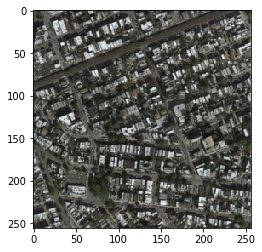

b


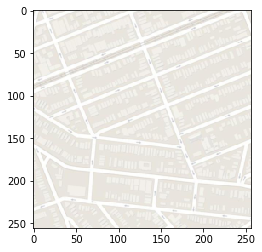

a->b


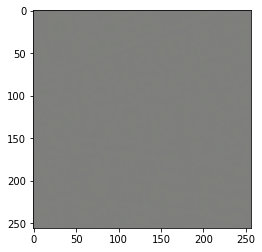

tensor(0.0071, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.9068, device='cuda:0', grad_fn=<AddBackward0>)
a


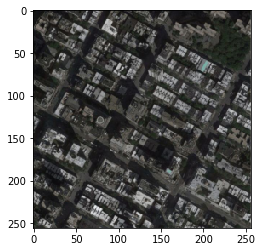

b


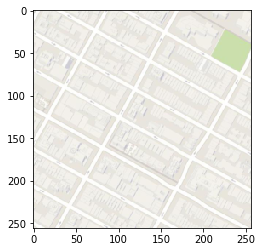

a->b


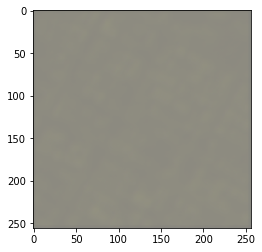

tensor(0.4988, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2527, device='cuda:0', grad_fn=<AddBackward0>)
a


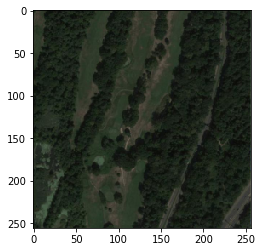

b


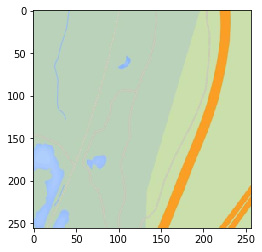

a->b


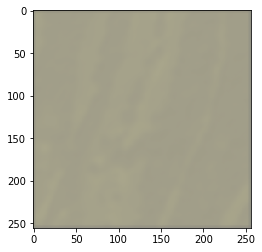

tensor(0.4415, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2447, device='cuda:0', grad_fn=<AddBackward0>)
a


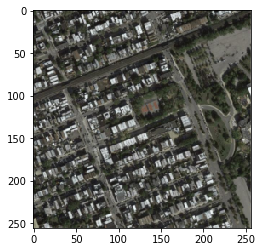

b


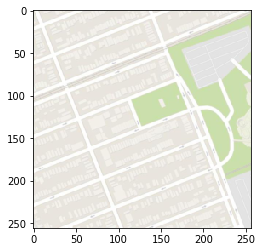

a->b


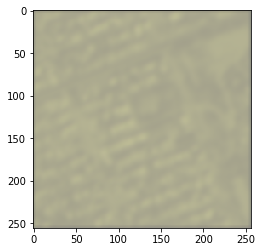

tensor(0.4965, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2481, device='cuda:0', grad_fn=<AddBackward0>)
a


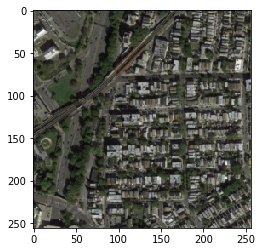

b


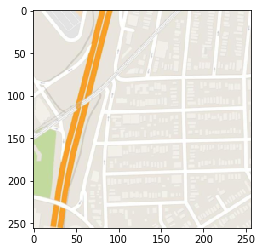

a->b


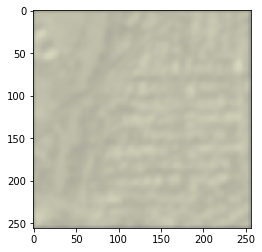

tensor(0.4616, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2561, device='cuda:0', grad_fn=<AddBackward0>)
a


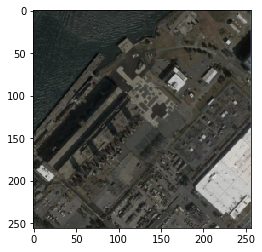

b


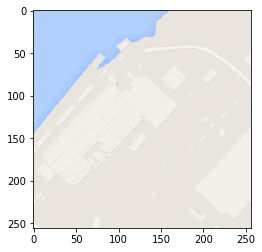

a->b


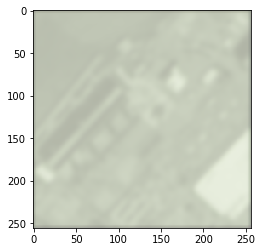

tensor(0.5439, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2065, device='cuda:0', grad_fn=<AddBackward0>)
a


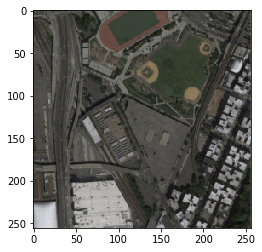

b


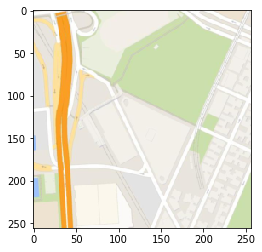

a->b


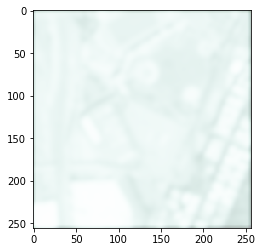

tensor(0.5042, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2585, device='cuda:0', grad_fn=<AddBackward0>)
a


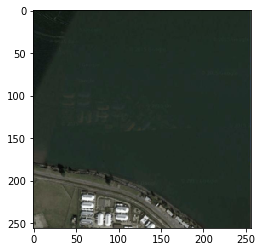

b


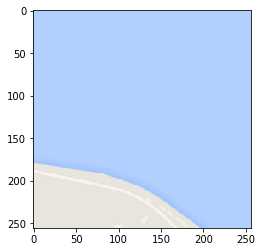

a->b


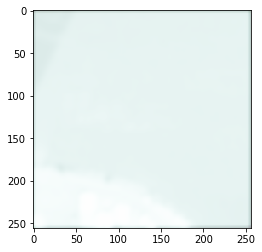

tensor(0.5010, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2515, device='cuda:0', grad_fn=<AddBackward0>)
a


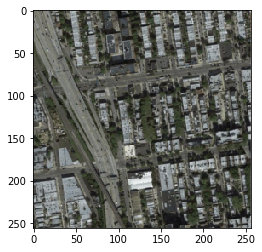

b


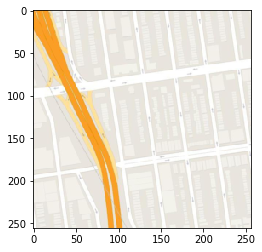

a->b


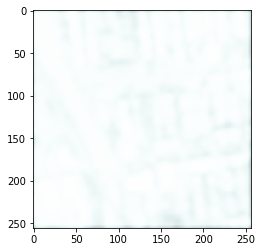

tensor(0.5001, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2512, device='cuda:0', grad_fn=<AddBackward0>)
a


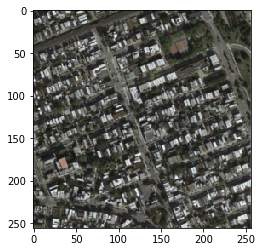

b


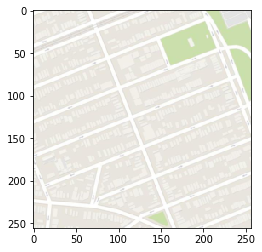

a->b


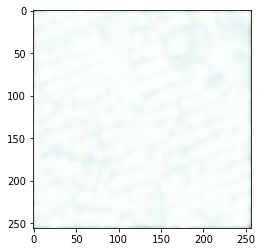

tensor(0.4998, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2516, device='cuda:0', grad_fn=<AddBackward0>)
a


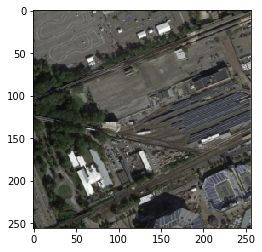

b


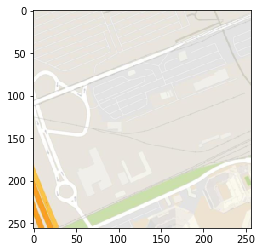

a->b


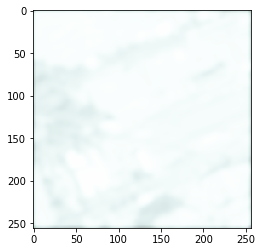

tensor(0.4995, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2513, device='cuda:0', grad_fn=<AddBackward0>)
a


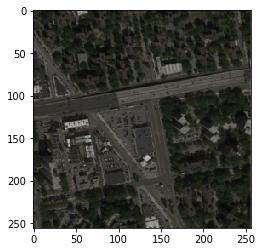

b


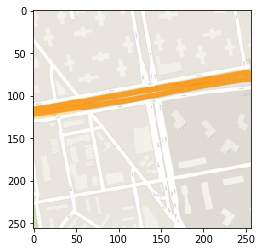

a->b


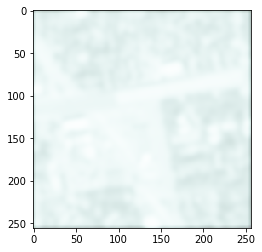

tensor(0.4990, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2525, device='cuda:0', grad_fn=<AddBackward0>)
a


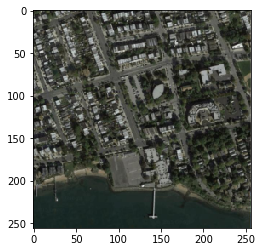

b


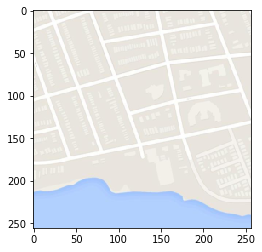

a->b


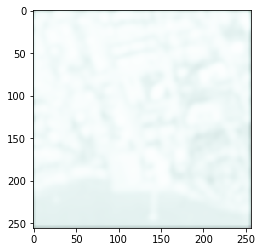

tensor(0.4973, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2600, device='cuda:0', grad_fn=<AddBackward0>)
a


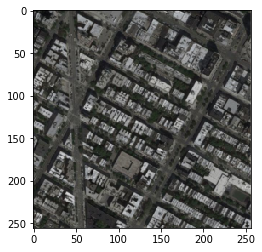

b


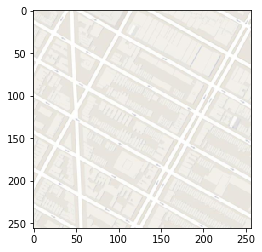

a->b


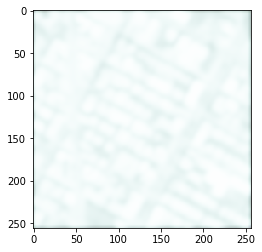

tensor(0.4901, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2747, device='cuda:0', grad_fn=<AddBackward0>)
a


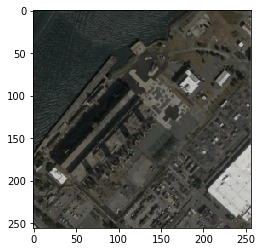

b


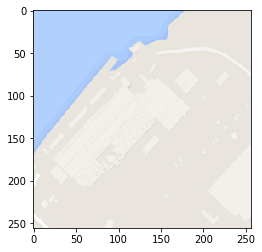

a->b


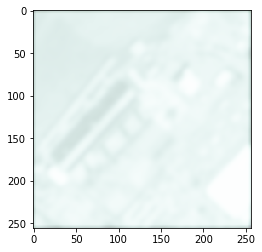

tensor(0.5197, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2194, device='cuda:0', grad_fn=<AddBackward0>)
a


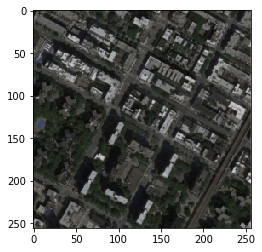

b


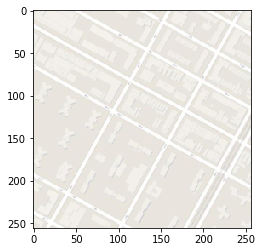

a->b


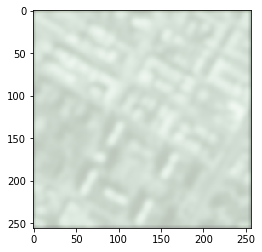

tensor(0.5014, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2463, device='cuda:0', grad_fn=<AddBackward0>)
a


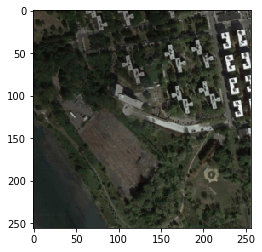

b


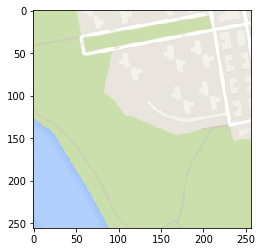

a->b


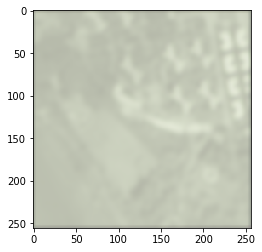

tensor(0.5023, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2480, device='cuda:0', grad_fn=<AddBackward0>)
a


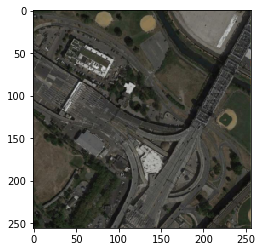

b


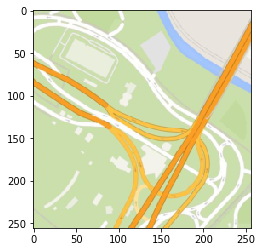

a->b


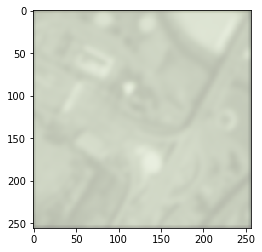

tensor(0.4946, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2578, device='cuda:0', grad_fn=<AddBackward0>)
a


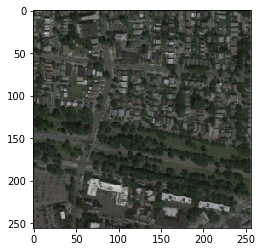

b


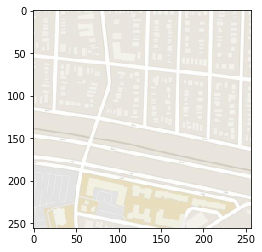

a->b


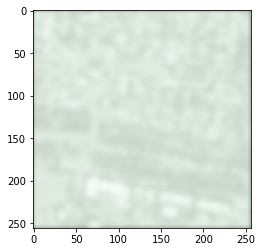

tensor(0.5174, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2615, device='cuda:0', grad_fn=<AddBackward0>)
a


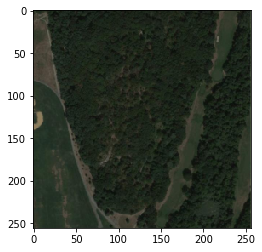

b


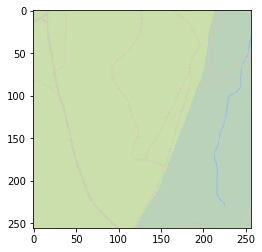

a->b


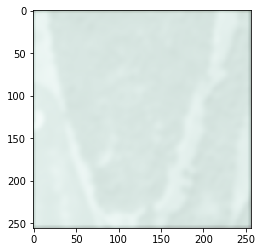

tensor(0.4998, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2542, device='cuda:0', grad_fn=<AddBackward0>)
a


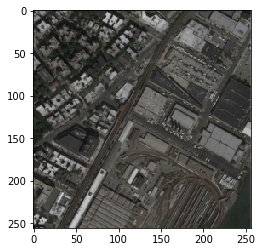

b


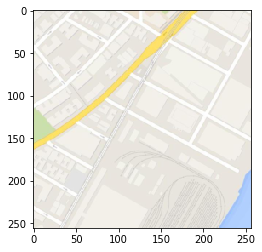

a->b


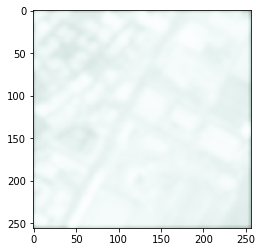

tensor(0.4973, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2566, device='cuda:0', grad_fn=<AddBackward0>)
a


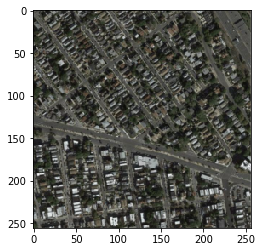

b


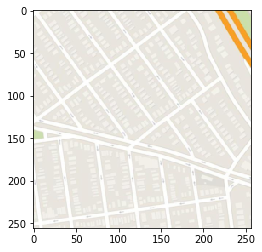

a->b


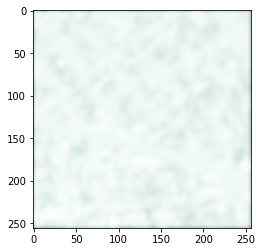

tensor(0.4963, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2627, device='cuda:0', grad_fn=<AddBackward0>)
a


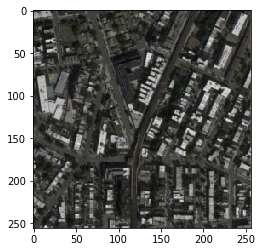

b


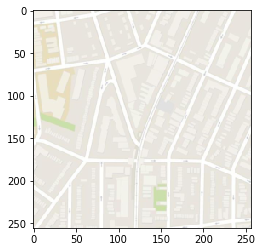

a->b


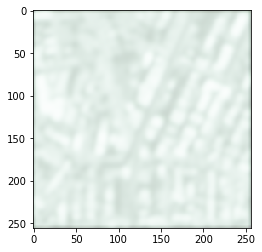

tensor(0.5076, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2430, device='cuda:0', grad_fn=<AddBackward0>)
a


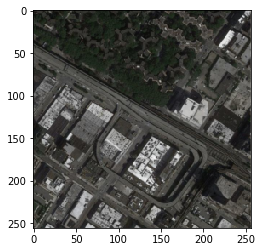

b


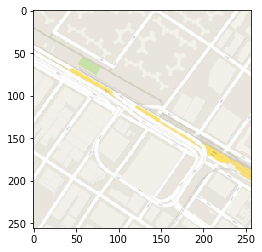

a->b


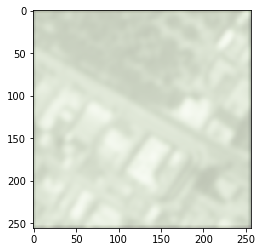

tensor(0.5002, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2472, device='cuda:0', grad_fn=<AddBackward0>)
a


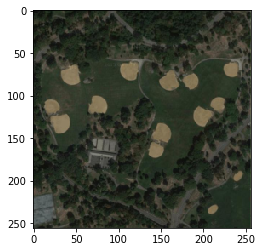

b


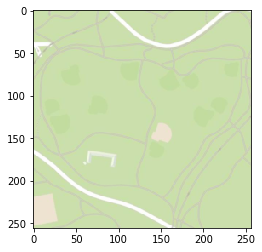

a->b


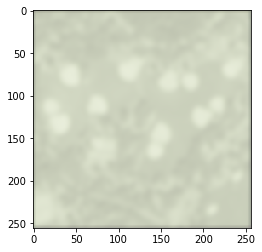

tensor(0.5110, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2406, device='cuda:0', grad_fn=<AddBackward0>)
a


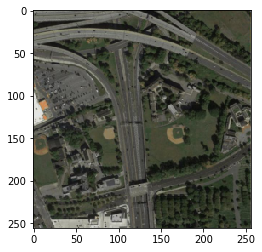

b


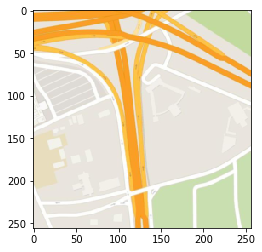

a->b


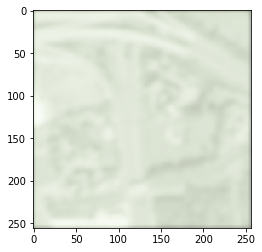

tensor(0.5019, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2516, device='cuda:0', grad_fn=<AddBackward0>)
a


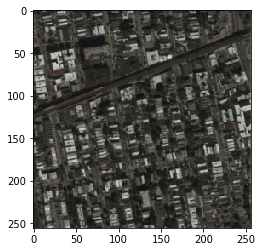

b


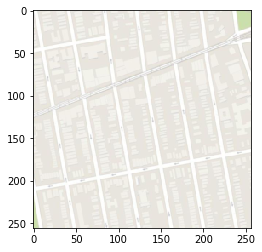

a->b


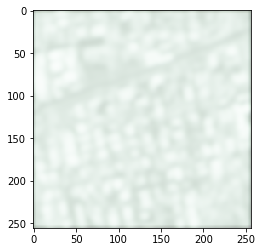

tensor(0.4996, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2551, device='cuda:0', grad_fn=<AddBackward0>)
a


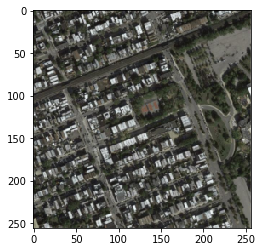

b


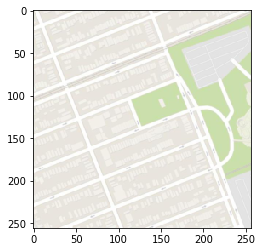

a->b


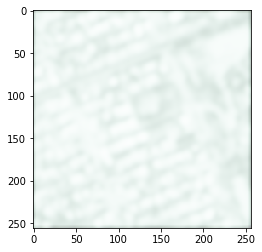

tensor(0.4954, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2532, device='cuda:0', grad_fn=<AddBackward0>)
a


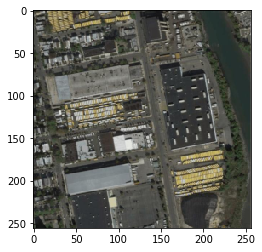

b


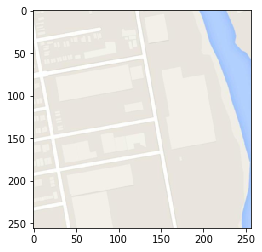

a->b


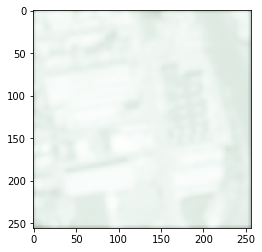

tensor(0.5104, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2543, device='cuda:0', grad_fn=<AddBackward0>)
a


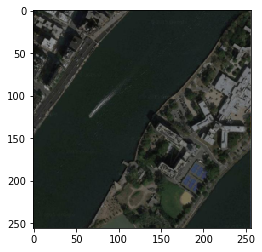

b


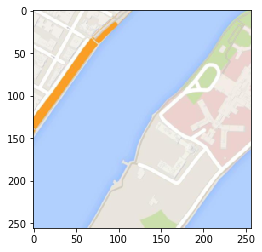

a->b


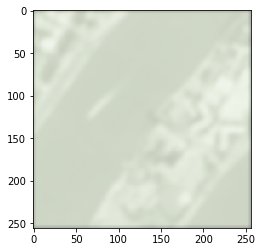

tensor(0.5005, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2425, device='cuda:0', grad_fn=<AddBackward0>)
a


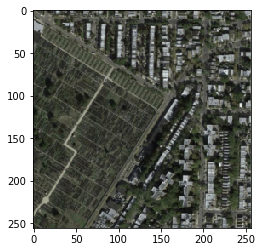

b


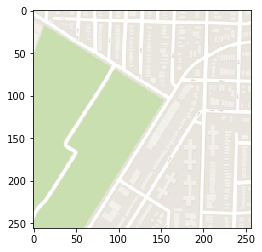

a->b


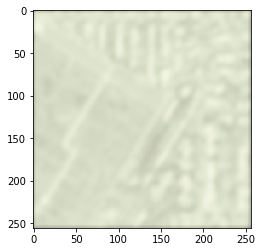

tensor(0.4841, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2503, device='cuda:0', grad_fn=<AddBackward0>)
a


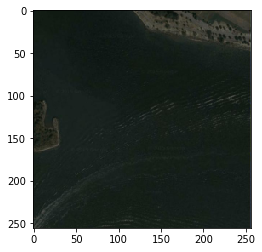

b


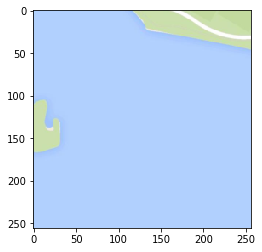

a->b


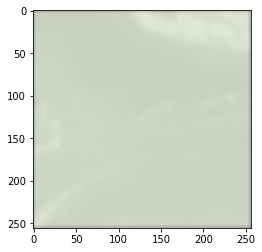

tensor(0.5027, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2513, device='cuda:0', grad_fn=<AddBackward0>)
a


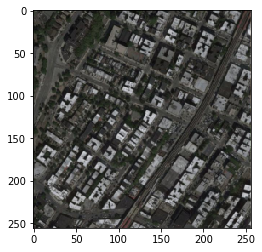

b


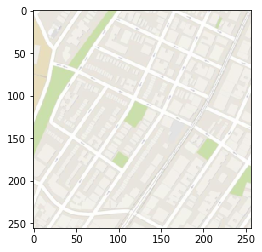

a->b


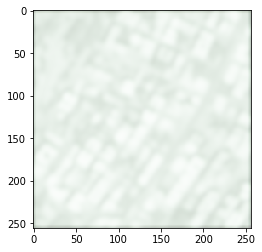

tensor(0.4967, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2608, device='cuda:0', grad_fn=<AddBackward0>)
a


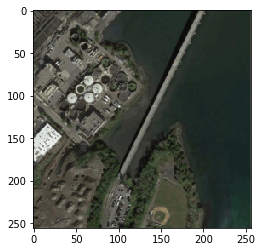

b


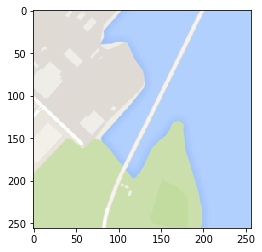

a->b


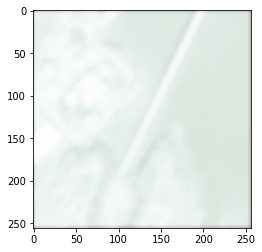

tensor(0.5139, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2503, device='cuda:0', grad_fn=<AddBackward0>)
a


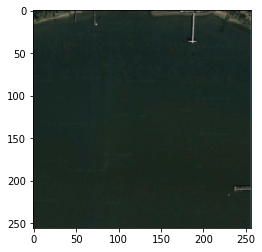

b


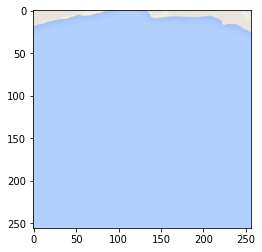

a->b


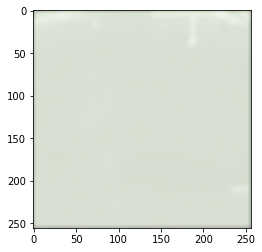

tensor(0.5015, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2419, device='cuda:0', grad_fn=<AddBackward0>)
a


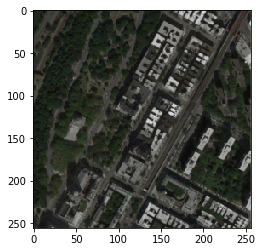

b


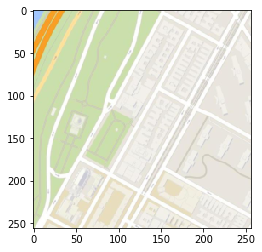

a->b


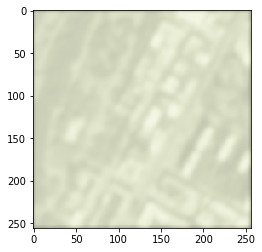

tensor(0.5002, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2499, device='cuda:0', grad_fn=<AddBackward0>)
a


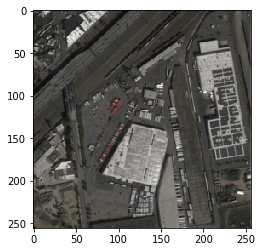

b


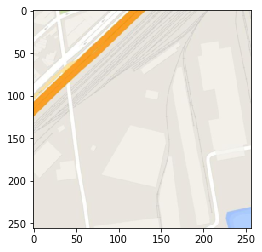

a->b


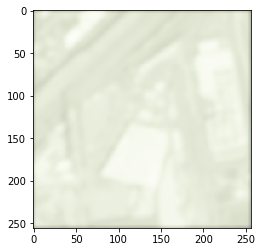

tensor(0.4994, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2611, device='cuda:0', grad_fn=<AddBackward0>)
a


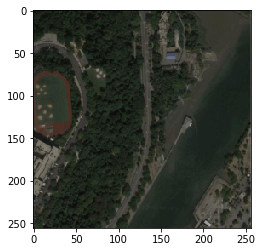

b


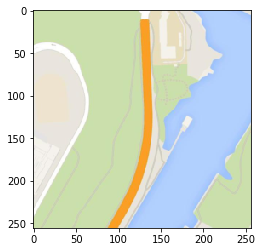

a->b


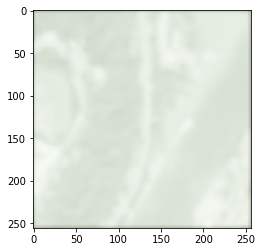

tensor(0.4979, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2521, device='cuda:0', grad_fn=<AddBackward0>)
a


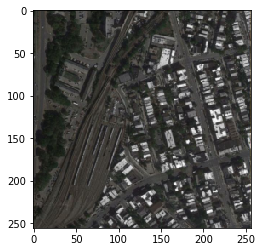

b


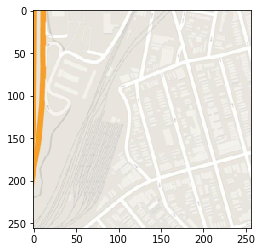

a->b


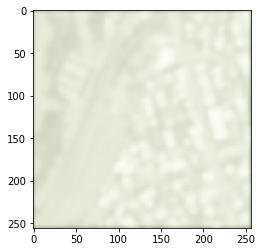

tensor(0.3850, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2212, device='cuda:0', grad_fn=<AddBackward0>)
a


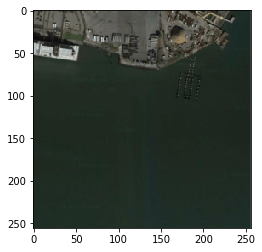

b


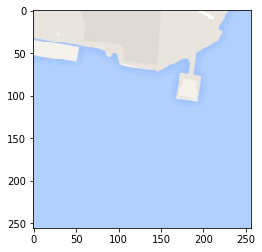

a->b


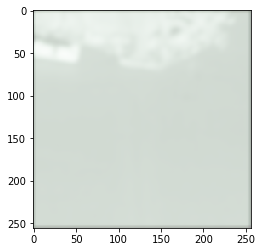

tensor(0.4996, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2548, device='cuda:0', grad_fn=<AddBackward0>)
a


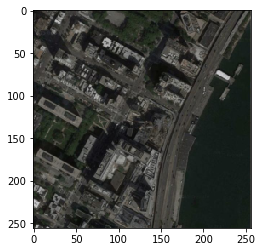

b


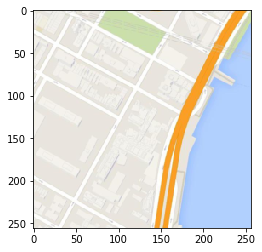

a->b


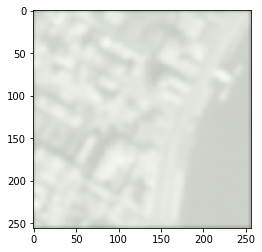

tensor(0.4994, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2540, device='cuda:0', grad_fn=<AddBackward0>)
a


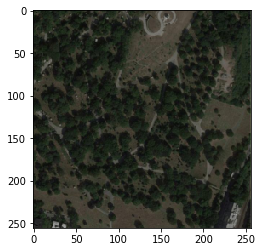

b


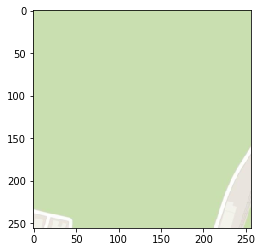

a->b


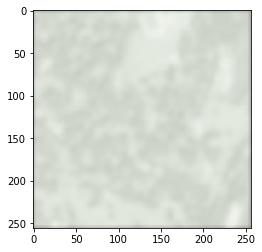

tensor(0.5000, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2502, device='cuda:0', grad_fn=<AddBackward0>)
a


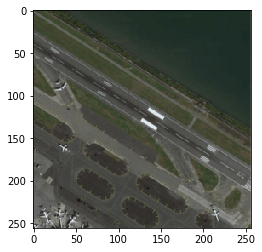

b


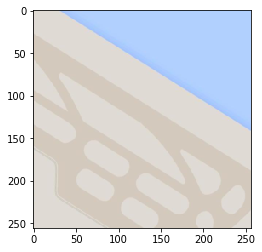

a->b


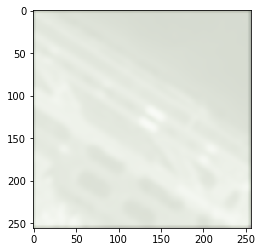

tensor(0.5000, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2544, device='cuda:0', grad_fn=<AddBackward0>)
a


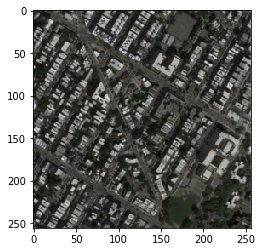

b


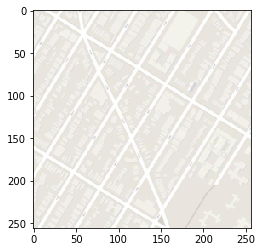

a->b


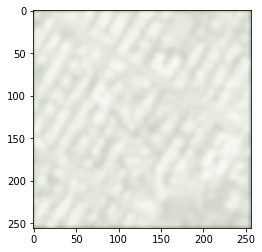

tensor(0.5000, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2516, device='cuda:0', grad_fn=<AddBackward0>)
a


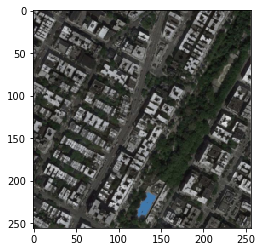

b


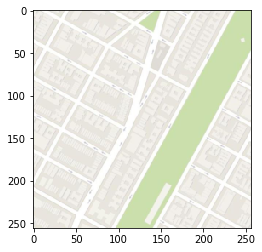

a->b


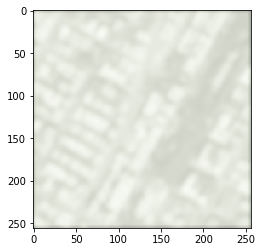

tensor(0.4969, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2450, device='cuda:0', grad_fn=<AddBackward0>)
a


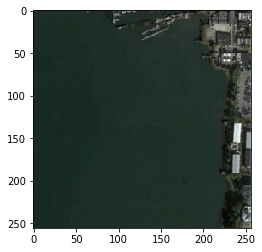

b


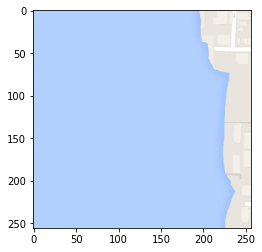

a->b


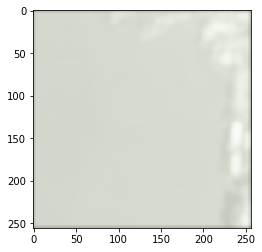

tensor(0.4989, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2489, device='cuda:0', grad_fn=<AddBackward0>)
a


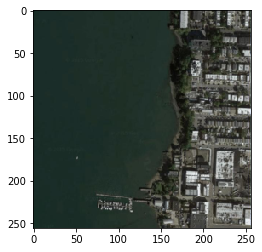

b


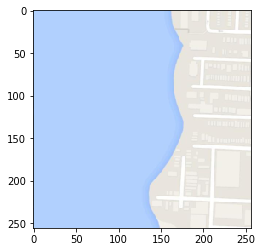

a->b


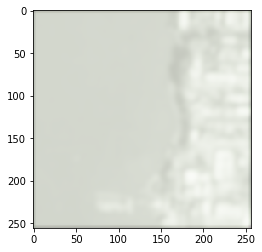

tensor(0.4995, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2501, device='cuda:0', grad_fn=<AddBackward0>)
a


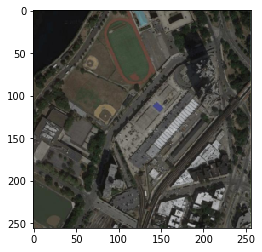

b


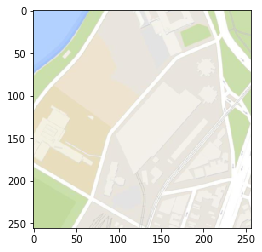

a->b


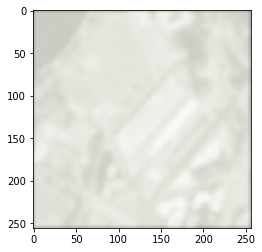

tensor(0.5001, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2516, device='cuda:0', grad_fn=<AddBackward0>)
a


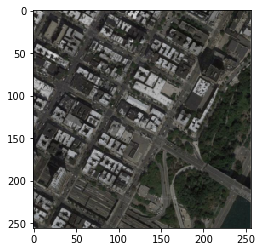

b


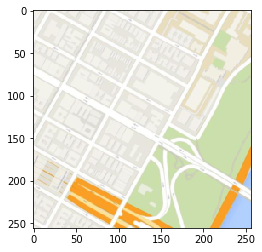

a->b


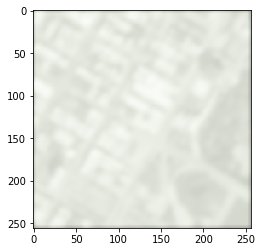

tensor(0.4989, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2485, device='cuda:0', grad_fn=<AddBackward0>)
a


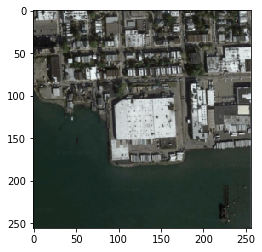

b


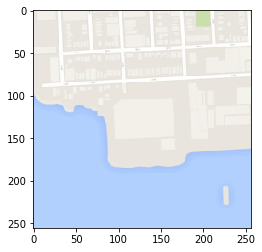

a->b


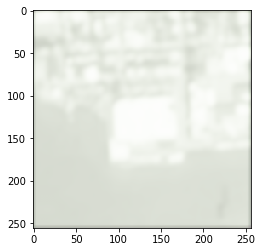

tensor(0.4988, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2533, device='cuda:0', grad_fn=<AddBackward0>)
a


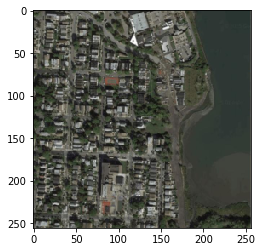

b


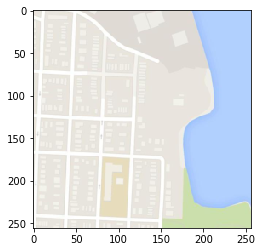

a->b


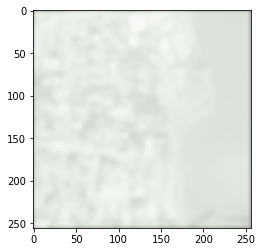

tensor(0.4969, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2464, device='cuda:0', grad_fn=<AddBackward0>)
a


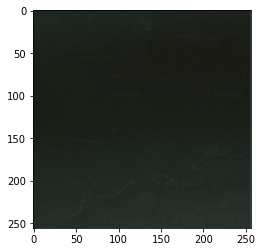

b


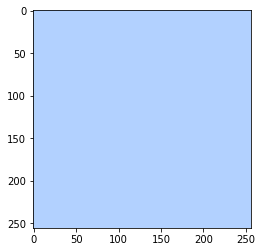

a->b


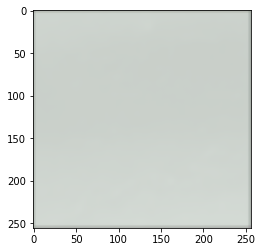

tensor(0.5006, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2518, device='cuda:0', grad_fn=<AddBackward0>)
a


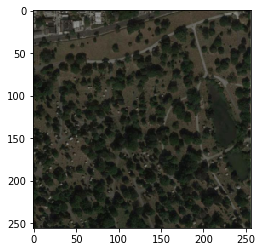

b


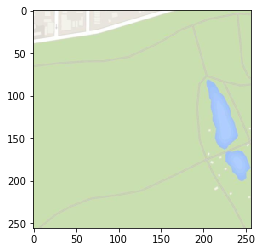

a->b


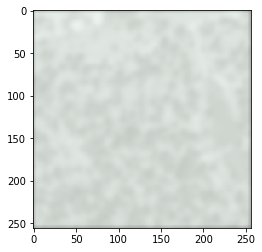

tensor(0.4994, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2510, device='cuda:0', grad_fn=<AddBackward0>)
a


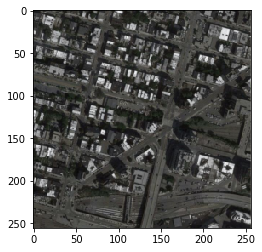

b


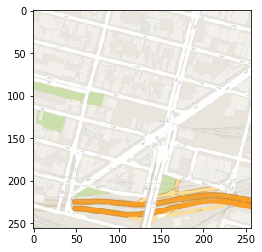

a->b


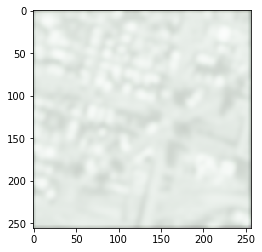

tensor(0.4990, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2479, device='cuda:0', grad_fn=<AddBackward0>)
a


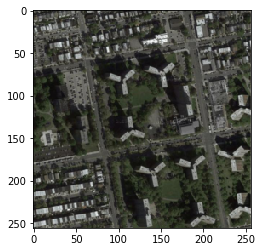

b


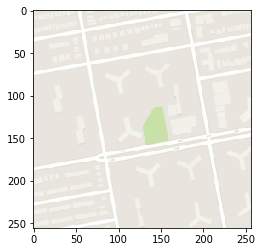

a->b


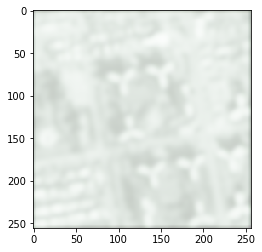

tensor(0.4967, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2437, device='cuda:0', grad_fn=<AddBackward0>)
a


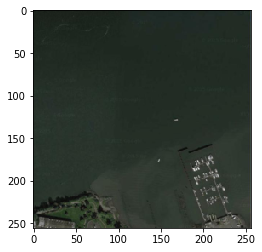

b


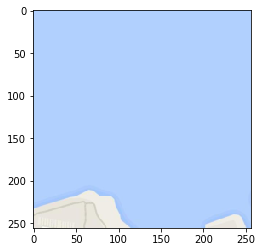

a->b


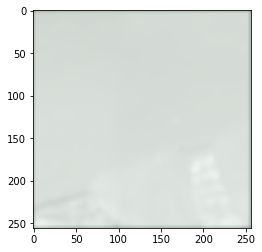

tensor(0.4970, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2550, device='cuda:0', grad_fn=<AddBackward0>)
a


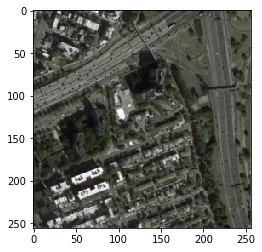

b


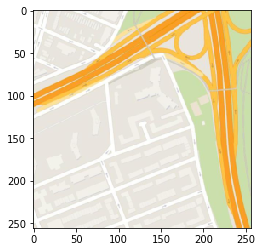

a->b


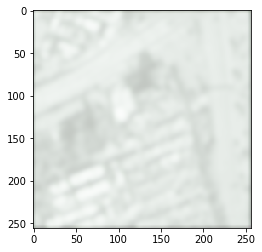

tensor(0.5052, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2649, device='cuda:0', grad_fn=<AddBackward0>)
a


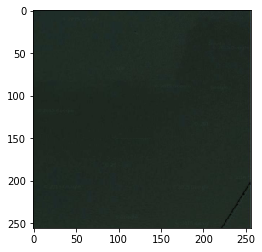

b


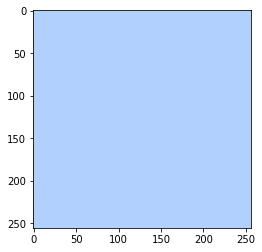

a->b


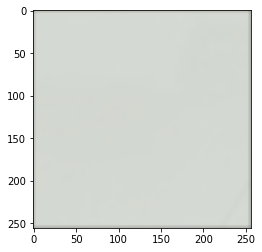

tensor(0.4976, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2447, device='cuda:0', grad_fn=<AddBackward0>)
a


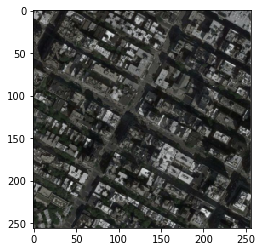

b


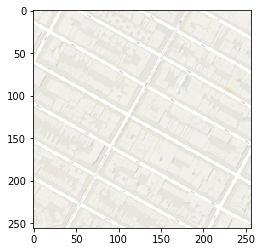

a->b


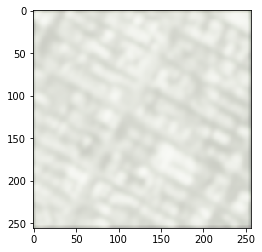

tensor(0.4983, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2865, device='cuda:0', grad_fn=<AddBackward0>)
a


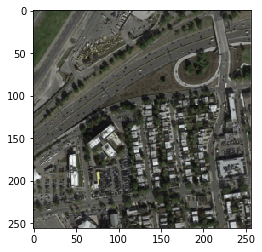

b


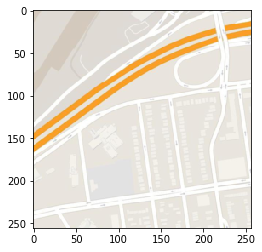

a->b


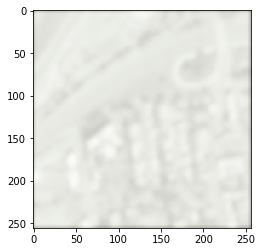

tensor(0.4996, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2126, device='cuda:0', grad_fn=<AddBackward0>)
a


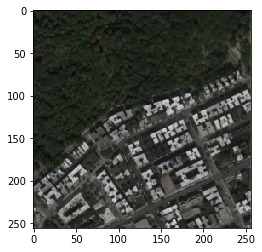

b


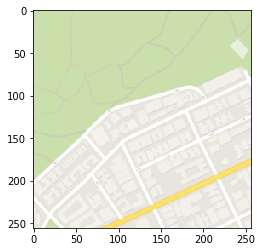

a->b


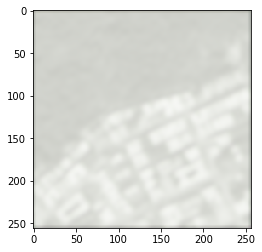

tensor(0.4825, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2577, device='cuda:0', grad_fn=<AddBackward0>)
a


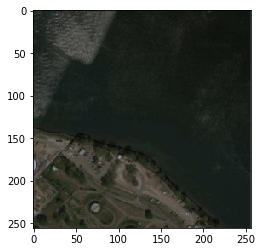

b


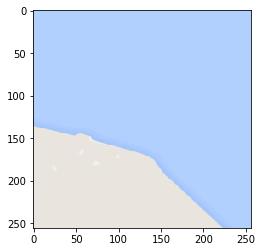

a->b


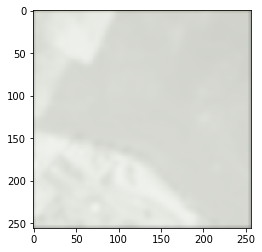

tensor(0.4843, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2549, device='cuda:0', grad_fn=<AddBackward0>)
a


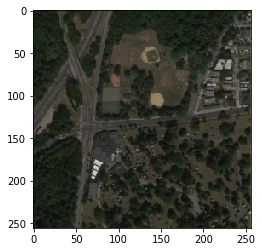

b


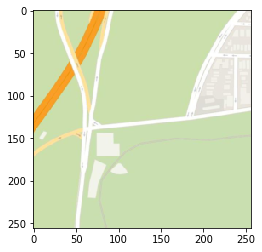

a->b


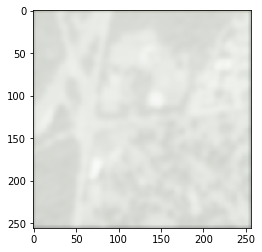

tensor(0.4664, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2617, device='cuda:0', grad_fn=<AddBackward0>)
a


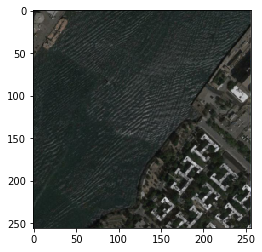

b


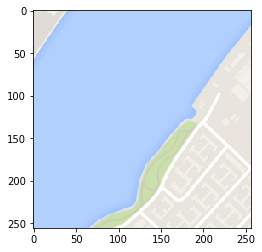

a->b


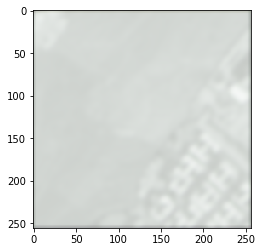

tensor(0.5463, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.1708, device='cuda:0', grad_fn=<AddBackward0>)
a


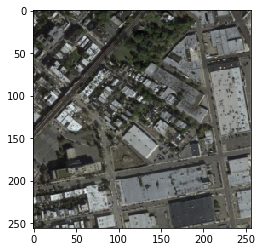

b


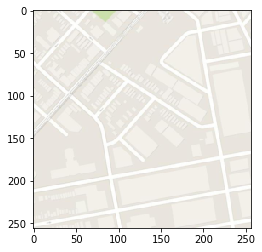

a->b


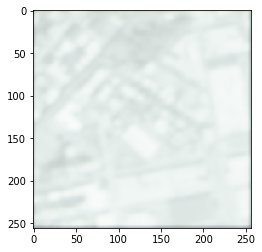

tensor(0.4806, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2142, device='cuda:0', grad_fn=<AddBackward0>)
a


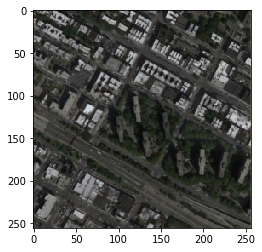

b


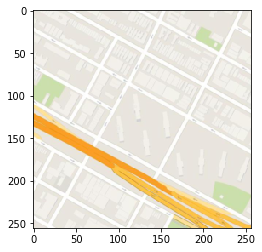

a->b


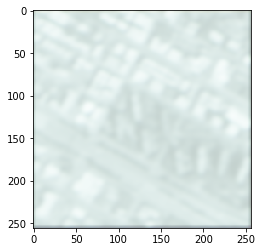

tensor(0.5072, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3600, device='cuda:0', grad_fn=<AddBackward0>)
a


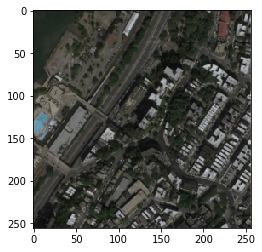

b


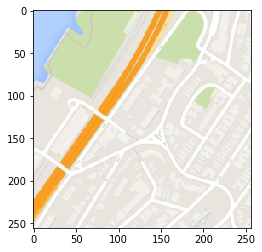

a->b


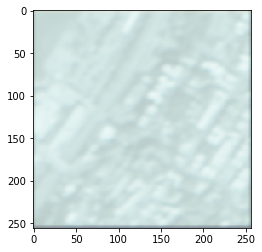

tensor(0.5035, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2880, device='cuda:0', grad_fn=<AddBackward0>)
a


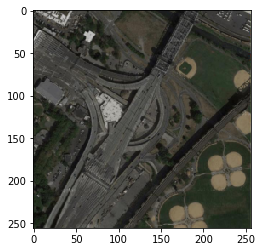

b


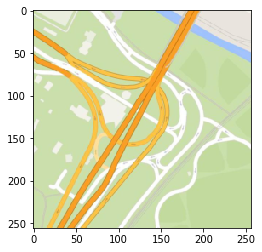

a->b


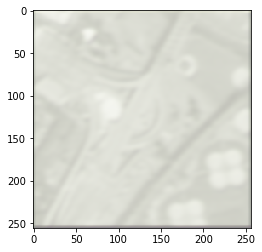

tensor(0.5037, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2606, device='cuda:0', grad_fn=<AddBackward0>)
a


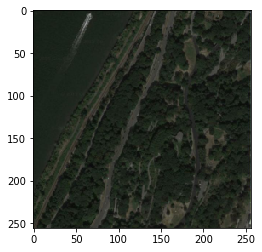

b


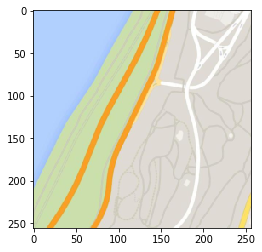

a->b


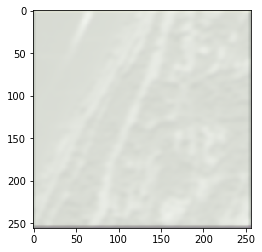

tensor(0.5015, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2437, device='cuda:0', grad_fn=<AddBackward0>)
a


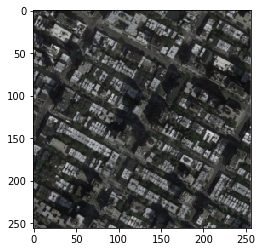

b


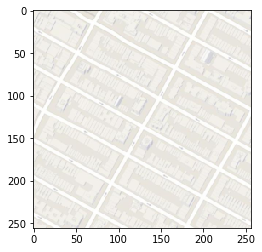

a->b


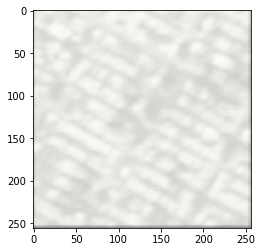

tensor(0.5025, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2404, device='cuda:0', grad_fn=<AddBackward0>)
a


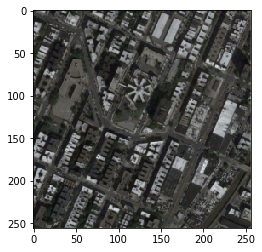

b


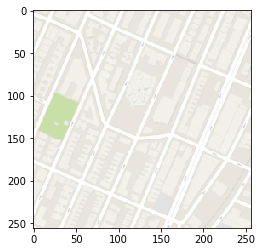

a->b


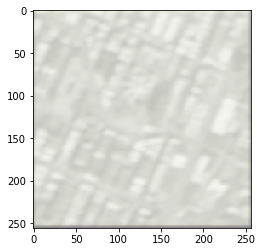

tensor(0.5231, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2371, device='cuda:0', grad_fn=<AddBackward0>)
a


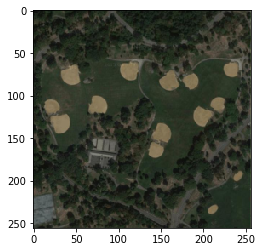

b


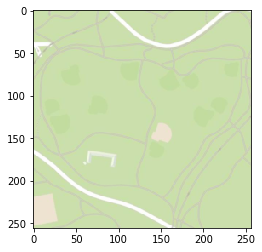

a->b


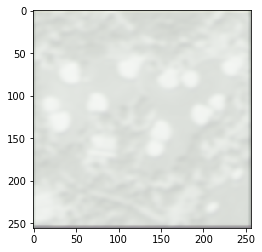

tensor(0.4574, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2689, device='cuda:0', grad_fn=<AddBackward0>)
a


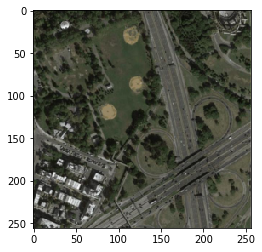

b


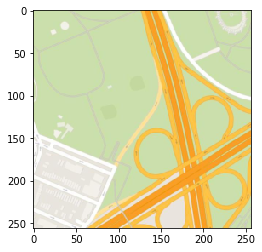

a->b


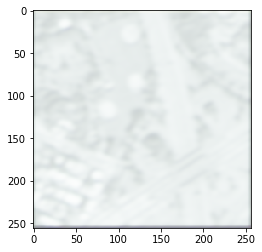

tensor(0.4588, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2264, device='cuda:0', grad_fn=<AddBackward0>)
a


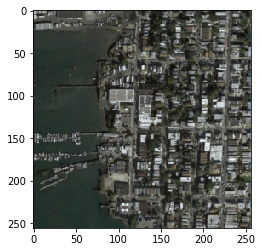

b


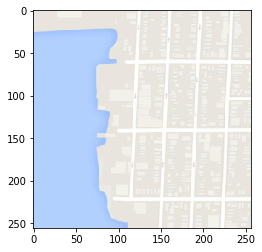

a->b


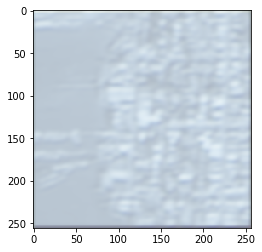

tensor(0.4980, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2637, device='cuda:0', grad_fn=<AddBackward0>)
a


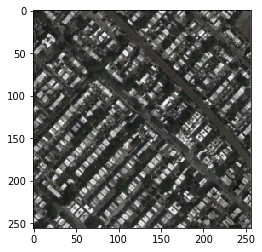

b


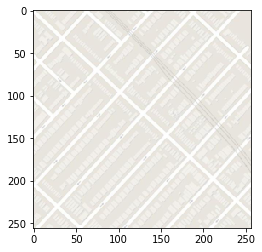

a->b


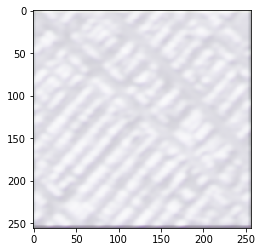

tensor(0.4956, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2539, device='cuda:0', grad_fn=<AddBackward0>)
a


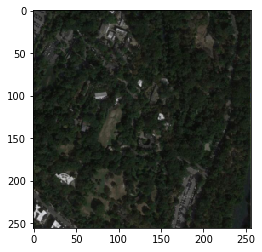

b


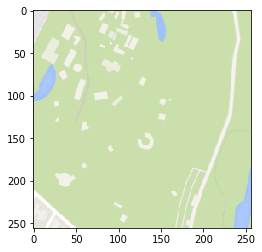

a->b


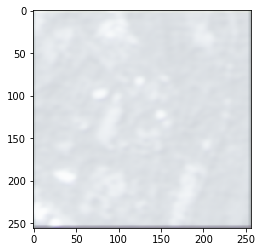

tensor(0.5032, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2518, device='cuda:0', grad_fn=<AddBackward0>)
a


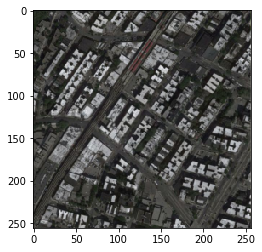

b


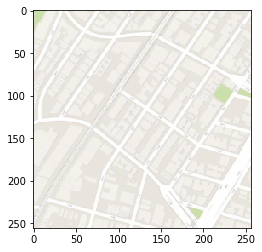

a->b


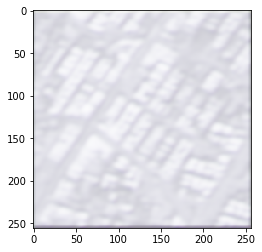

tensor(0.4854, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2355, device='cuda:0', grad_fn=<AddBackward0>)
a


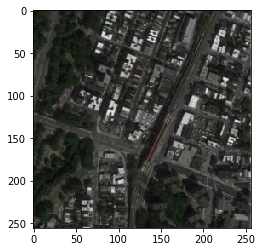

b


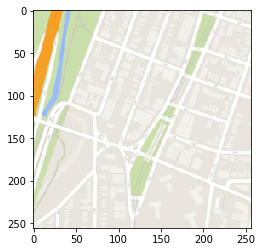

a->b


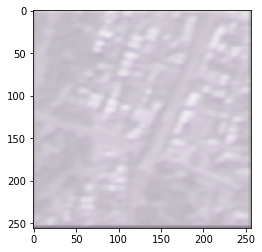

tensor(0.4972, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3291, device='cuda:0', grad_fn=<AddBackward0>)
a


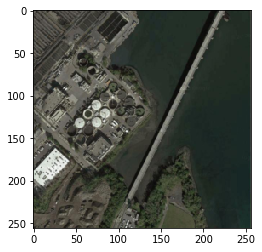

b


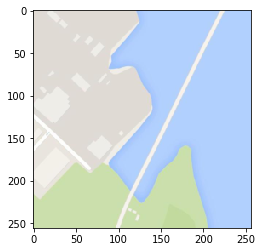

a->b


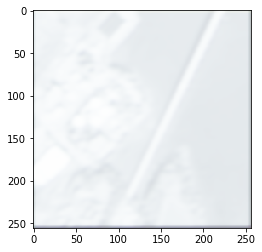

tensor(0.4198, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2711, device='cuda:0', grad_fn=<AddBackward0>)
a


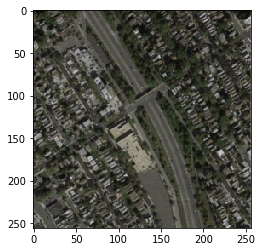

b


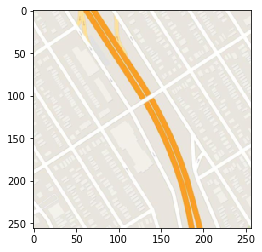

a->b


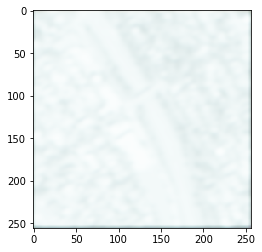

tensor(0.4563, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2116, device='cuda:0', grad_fn=<AddBackward0>)
a


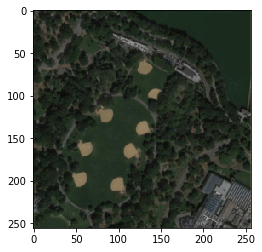

b


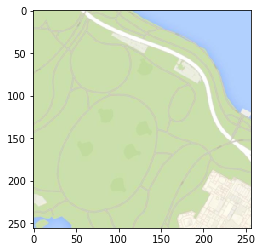

a->b


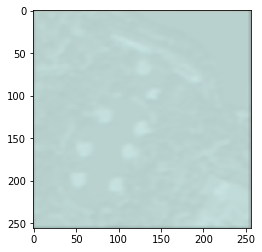

tensor(0.4646, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2572, device='cuda:0', grad_fn=<AddBackward0>)
a


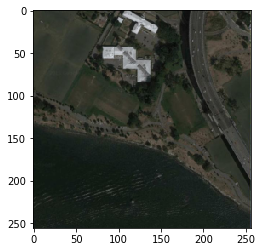

b


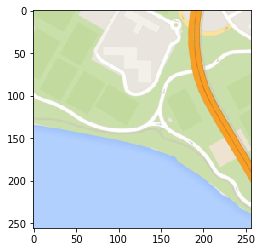

a->b


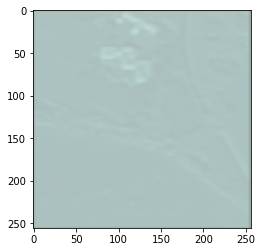

tensor(0.4509, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3276, device='cuda:0', grad_fn=<AddBackward0>)
a


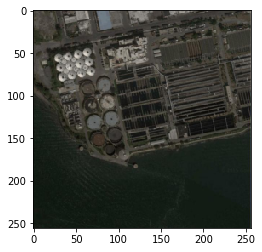

b


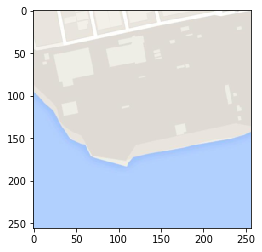

a->b


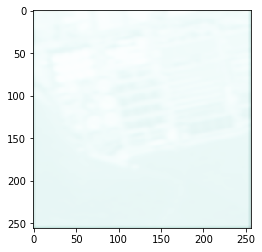

tensor(0.4695, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2296, device='cuda:0', grad_fn=<AddBackward0>)
a


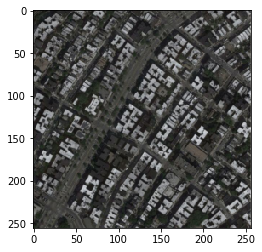

b


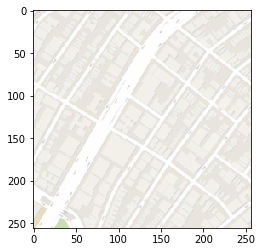

a->b


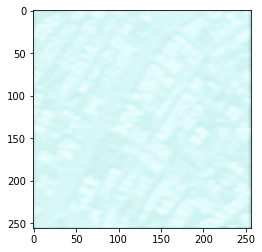

tensor(0.5852, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.5795, device='cuda:0', grad_fn=<AddBackward0>)
a


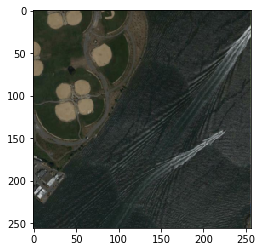

b


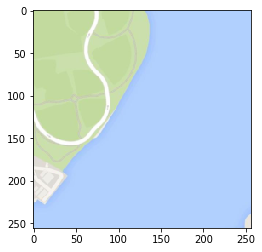

a->b


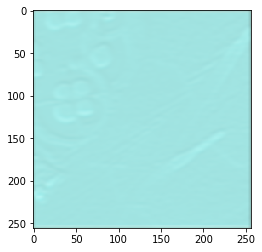

tensor(0.5112, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2546, device='cuda:0', grad_fn=<AddBackward0>)
a


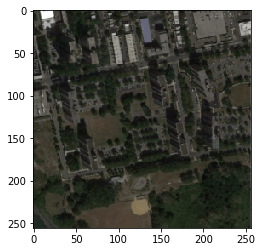

b


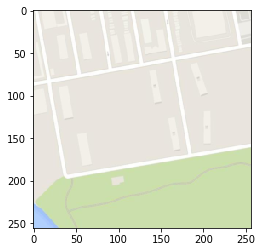

a->b


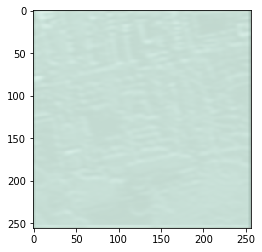

tensor(0.4972, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2672, device='cuda:0', grad_fn=<AddBackward0>)
a


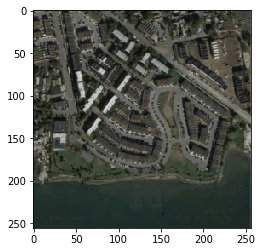

b


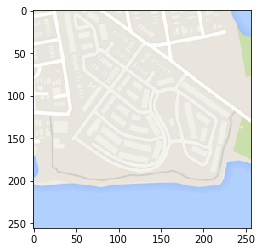

a->b


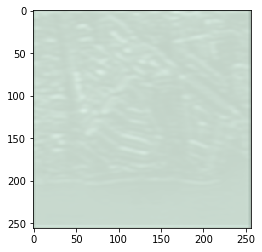

tensor(0.5118, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3344, device='cuda:0', grad_fn=<AddBackward0>)
a


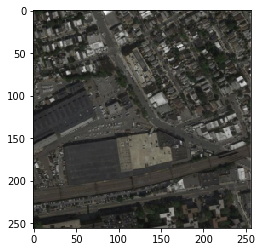

b


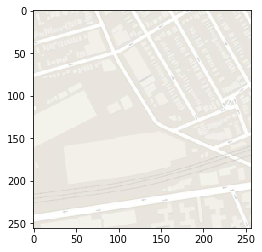

a->b


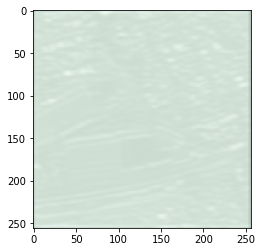

tensor(0.5022, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2247, device='cuda:0', grad_fn=<AddBackward0>)
a


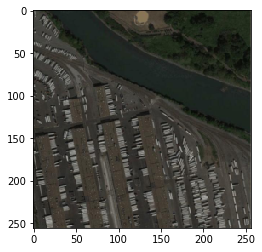

b


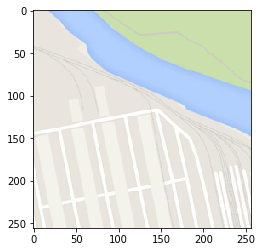

a->b


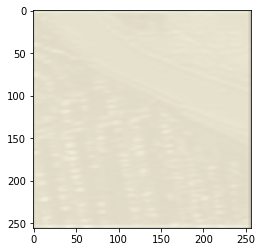

tensor(0.6003, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.1349, device='cuda:0', grad_fn=<AddBackward0>)
a


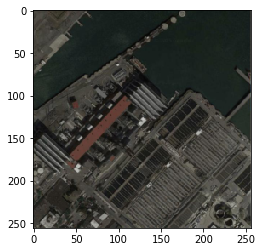

b


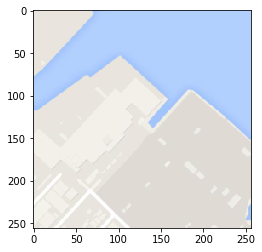

a->b


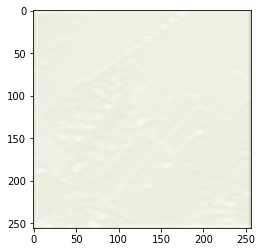

tensor(0.5112, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2577, device='cuda:0', grad_fn=<AddBackward0>)
a


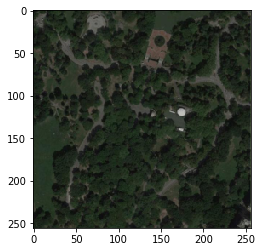

b


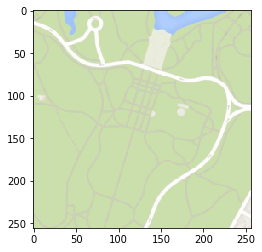

a->b


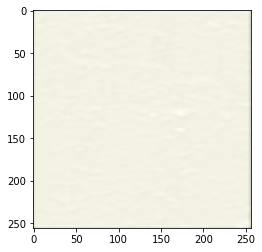

tensor(0.4996, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2502, device='cuda:0', grad_fn=<AddBackward0>)
a


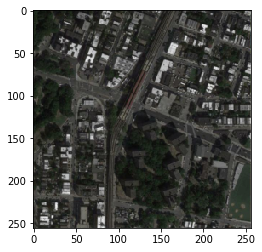

b


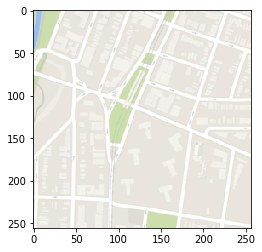

a->b


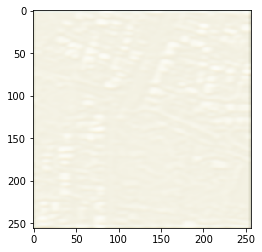

tensor(0.4901, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2525, device='cuda:0', grad_fn=<AddBackward0>)
a


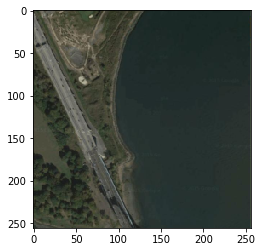

b


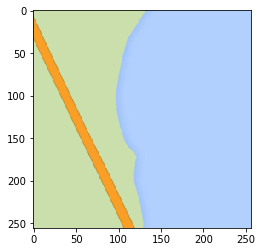

a->b


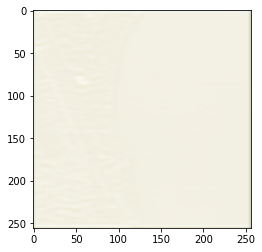

tensor(0.4452, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2547, device='cuda:0', grad_fn=<AddBackward0>)
a


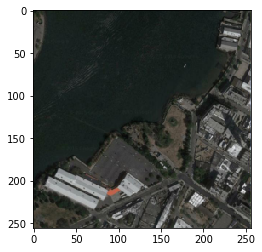

b


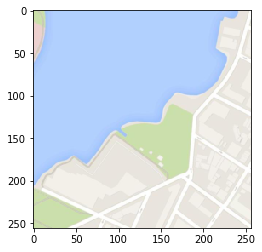

a->b


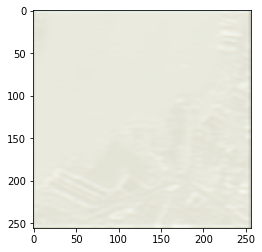

tensor(0.3879, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2662, device='cuda:0', grad_fn=<AddBackward0>)
a


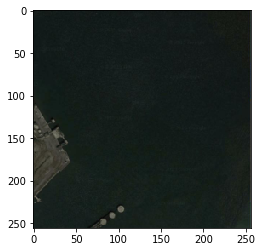

b


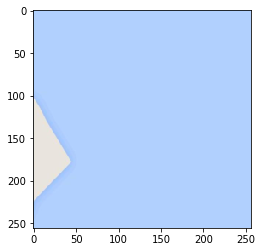

a->b


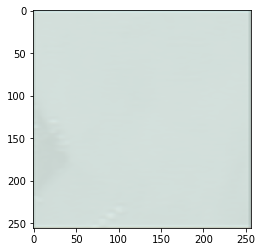

tensor(0.5481, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.5796, device='cuda:0', grad_fn=<AddBackward0>)
a


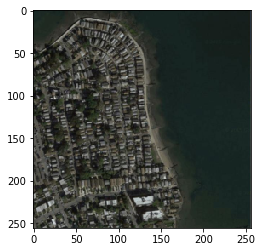

b


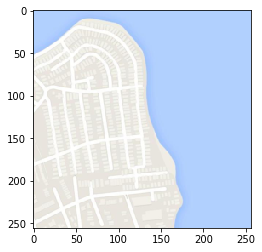

a->b


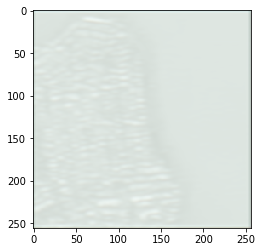

tensor(0.4964, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2530, device='cuda:0', grad_fn=<AddBackward0>)
a


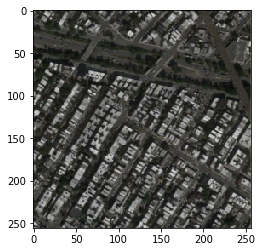

b


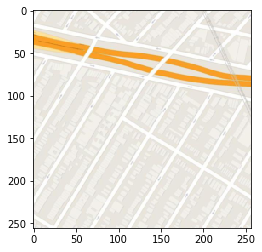

a->b


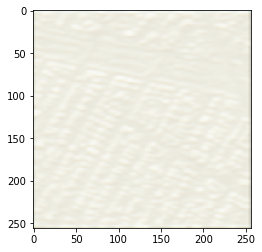

tensor(0.4992, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2559, device='cuda:0', grad_fn=<AddBackward0>)
a


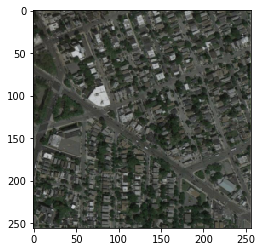

b


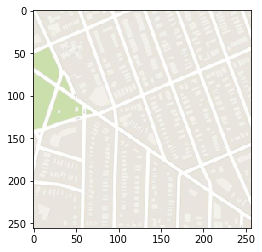

a->b


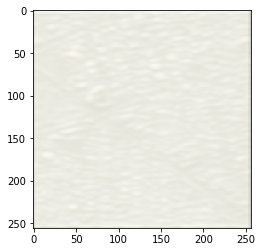

tensor(0.5605, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3334, device='cuda:0', grad_fn=<AddBackward0>)
a


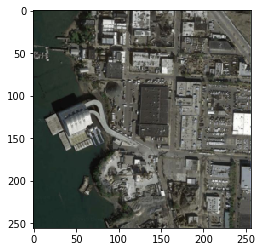

b


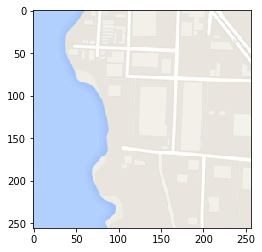

a->b


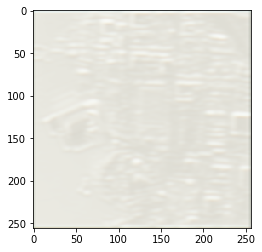

tensor(0.4957, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2377, device='cuda:0', grad_fn=<AddBackward0>)
a


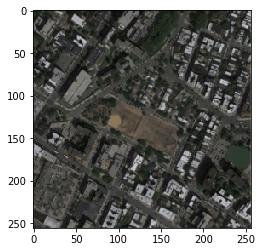

b


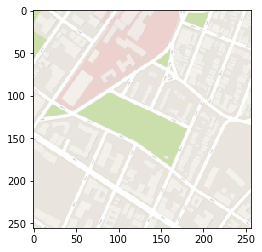

a->b


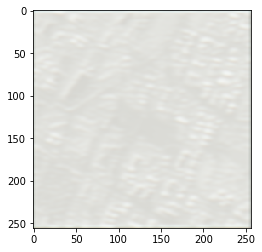

tensor(0.4941, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2483, device='cuda:0', grad_fn=<AddBackward0>)
a


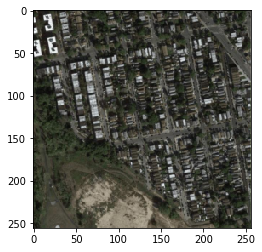

b


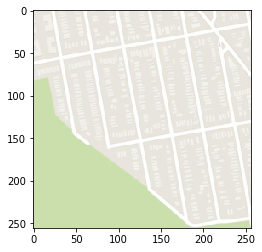

a->b


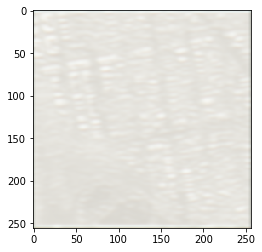

tensor(0.5005, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2443, device='cuda:0', grad_fn=<AddBackward0>)
a


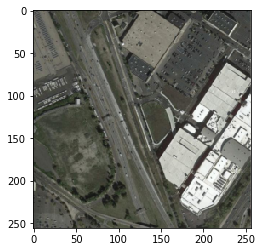

b


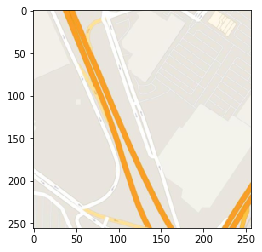

a->b


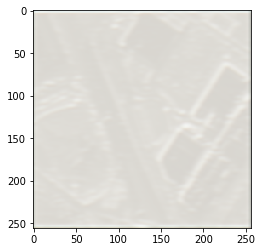

tensor(0.4715, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2255, device='cuda:0', grad_fn=<AddBackward0>)
a


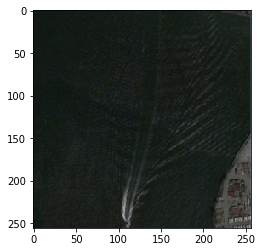

b


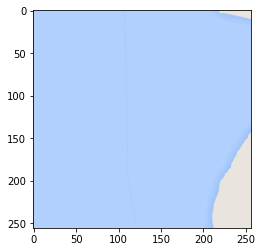

a->b


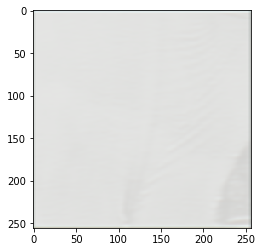

tensor(0.4877, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2735, device='cuda:0', grad_fn=<AddBackward0>)
a


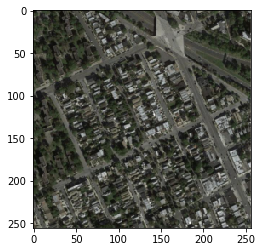

b


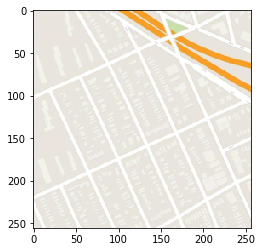

a->b


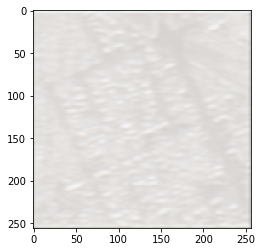

tensor(0.4847, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2916, device='cuda:0', grad_fn=<AddBackward0>)
a


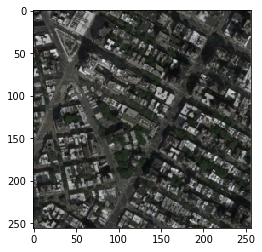

b


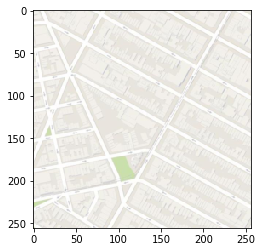

a->b


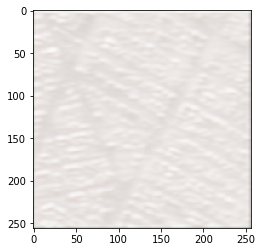

tensor(0.4588, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2949, device='cuda:0', grad_fn=<AddBackward0>)
a


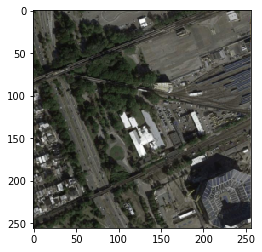

b


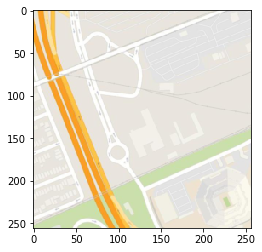

a->b


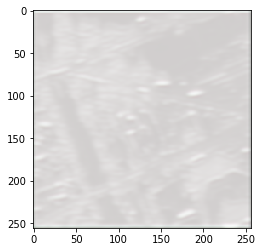

tensor(0.4970, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3000, device='cuda:0', grad_fn=<AddBackward0>)
a


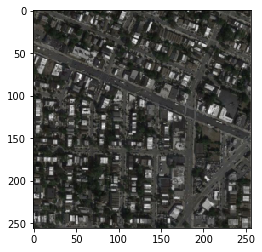

b


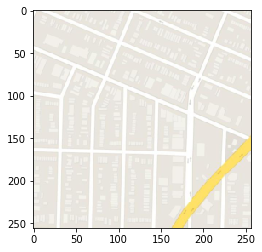

a->b


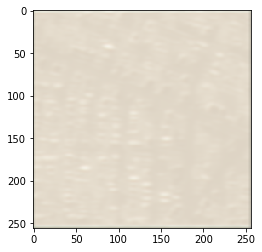

tensor(0.4774, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2608, device='cuda:0', grad_fn=<AddBackward0>)
a


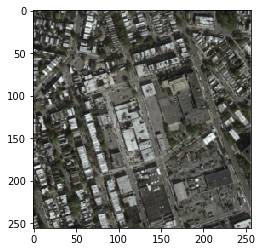

b


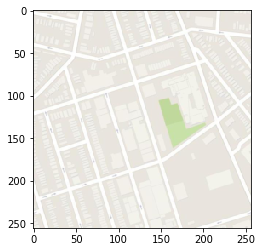

a->b


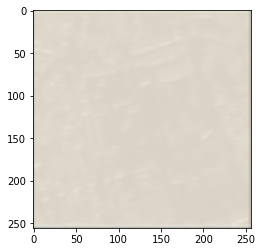

tensor(0.5072, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2713, device='cuda:0', grad_fn=<AddBackward0>)
a


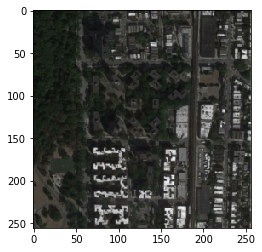

b


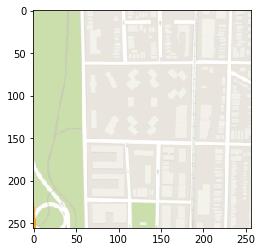

a->b


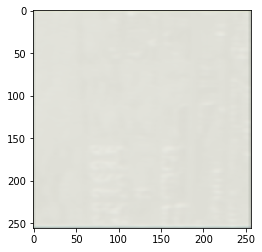

tensor(0.4790, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2693, device='cuda:0', grad_fn=<AddBackward0>)
a


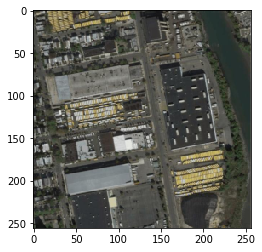

b


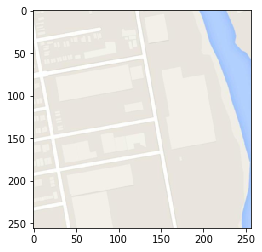

a->b


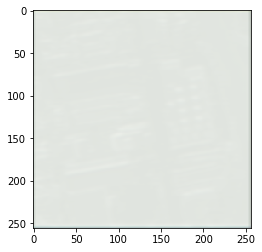

tensor(0.5191, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3507, device='cuda:0', grad_fn=<AddBackward0>)
a


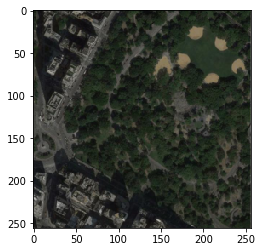

b


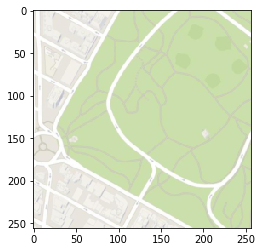

a->b


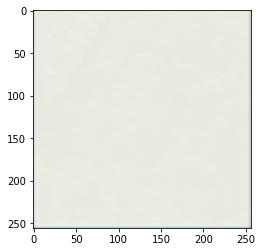

tensor(0.4721, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.1348, device='cuda:0', grad_fn=<AddBackward0>)
a


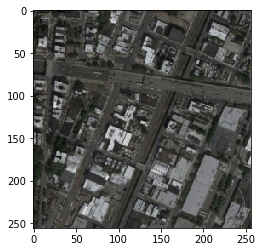

b


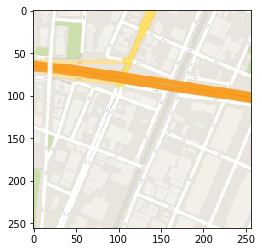

a->b


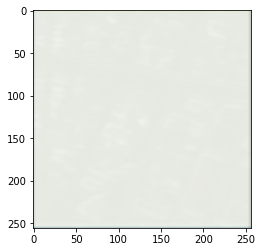

tensor(0.9578, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.0097, device='cuda:0', grad_fn=<AddBackward0>)
a


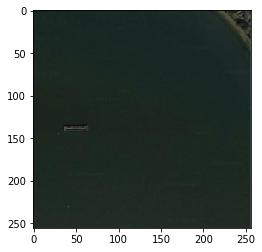

b


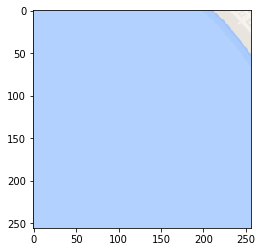

a->b


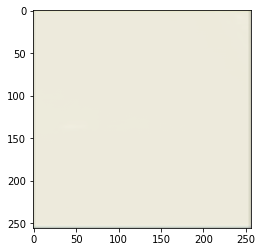

tensor(0.5039, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2654, device='cuda:0', grad_fn=<AddBackward0>)
a


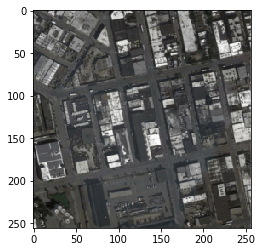

b


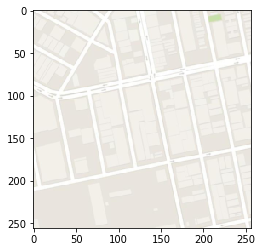

a->b


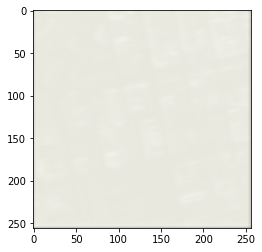

tensor(0.4920, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2623, device='cuda:0', grad_fn=<AddBackward0>)
a


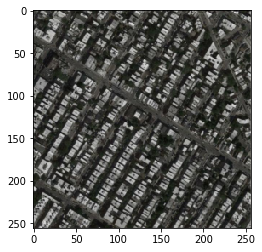

b


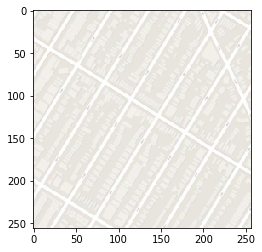

a->b


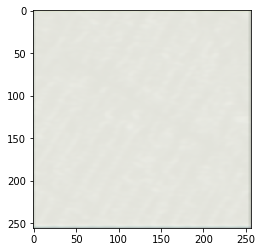

tensor(0.4571, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2923, device='cuda:0', grad_fn=<AddBackward0>)
a


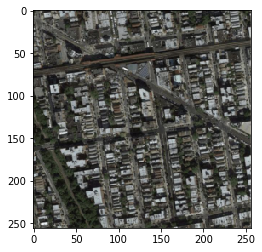

b


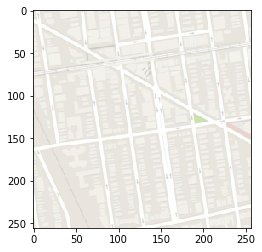

a->b


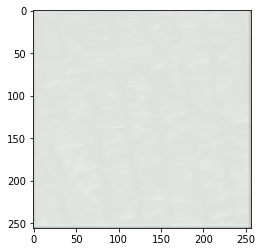

tensor(0.5154, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3545, device='cuda:0', grad_fn=<AddBackward0>)
a


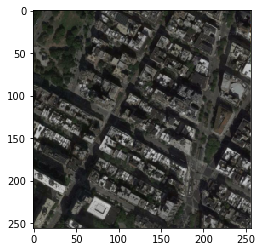

b


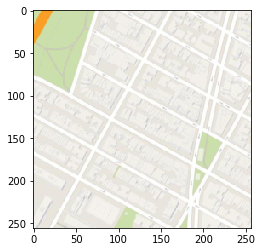

a->b


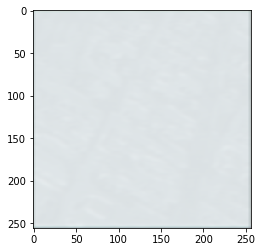

tensor(0.4156, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3149, device='cuda:0', grad_fn=<AddBackward0>)
a


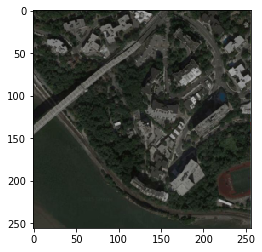

b


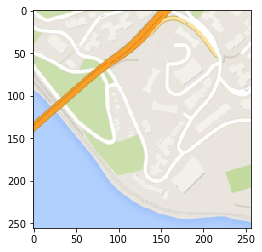

a->b


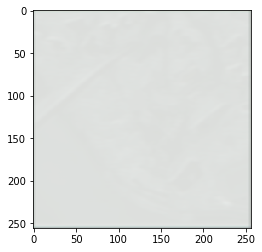

tensor(0.4981, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2502, device='cuda:0', grad_fn=<AddBackward0>)
a


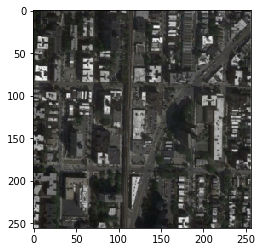

b


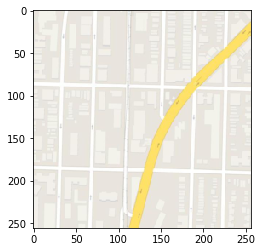

a->b


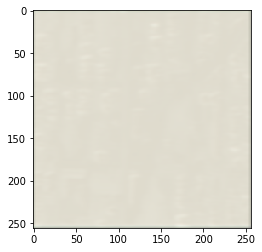

tensor(0.4558, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2423, device='cuda:0', grad_fn=<AddBackward0>)
a


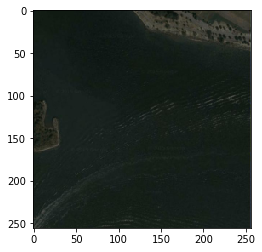

b


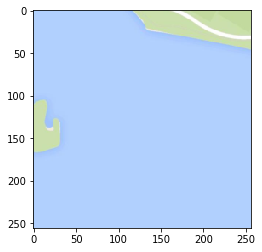

a->b


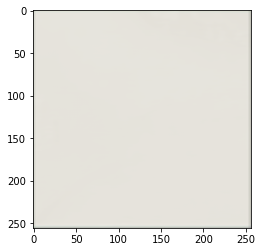

tensor(0.4982, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2562, device='cuda:0', grad_fn=<AddBackward0>)
a


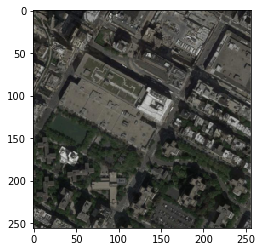

b


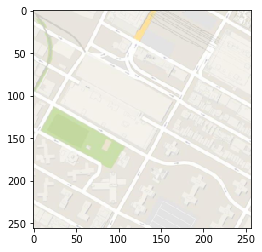

a->b


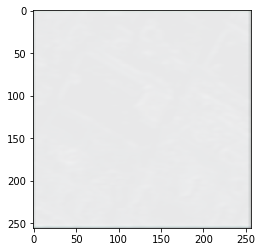

tensor(0.5454, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2755, device='cuda:0', grad_fn=<AddBackward0>)
a


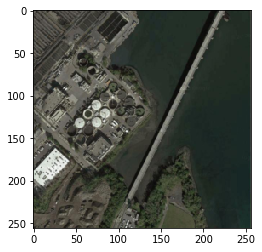

b


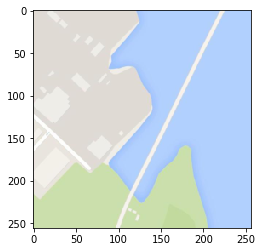

a->b


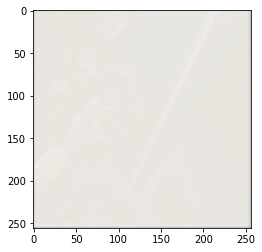

tensor(0.5036, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2819, device='cuda:0', grad_fn=<AddBackward0>)
a


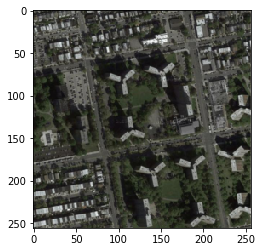

b


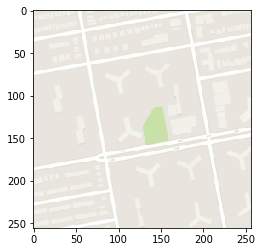

a->b


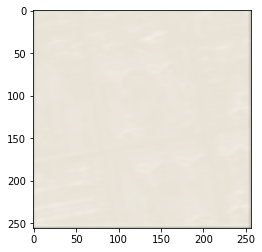

tensor(0.4391, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2561, device='cuda:0', grad_fn=<AddBackward0>)
a


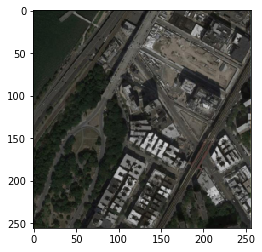

b


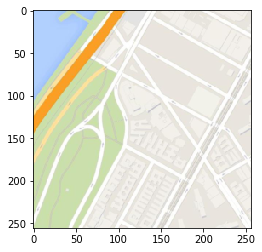

a->b


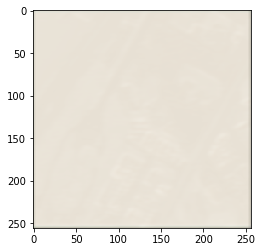

tensor(0.3648, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2800, device='cuda:0', grad_fn=<AddBackward0>)
a


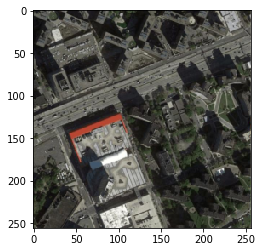

b


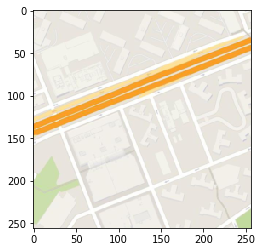

a->b


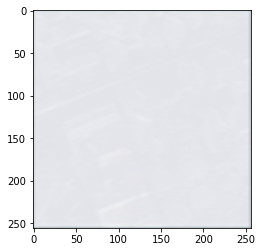

tensor(0.5222, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3656, device='cuda:0', grad_fn=<AddBackward0>)
a


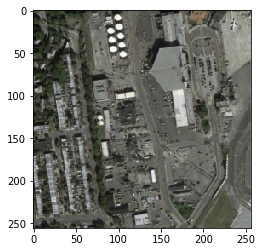

b


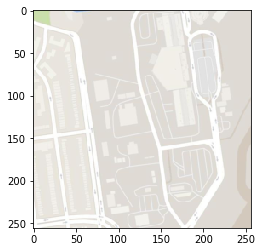

a->b


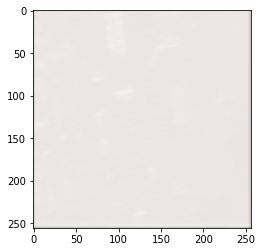

tensor(0.3667, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3600, device='cuda:0', grad_fn=<AddBackward0>)
a


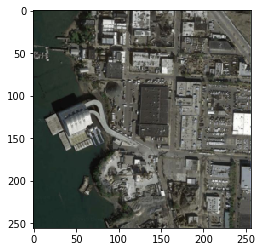

b


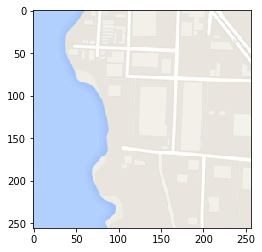

a->b


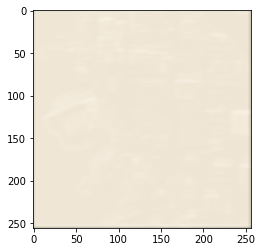

tensor(0.3670, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3437, device='cuda:0', grad_fn=<AddBackward0>)
a


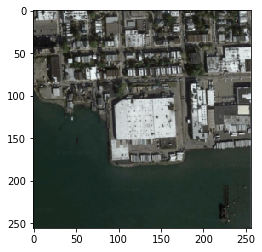

b


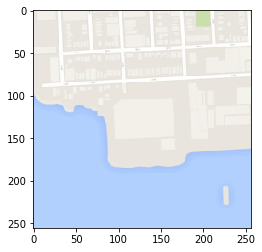

a->b


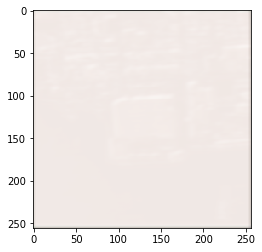

tensor(0.1198, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.4571, device='cuda:0', grad_fn=<AddBackward0>)
a


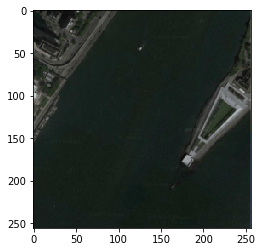

b


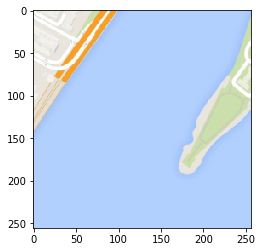

a->b


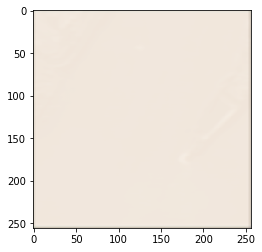

tensor(0.5065, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3347, device='cuda:0', grad_fn=<AddBackward0>)
a


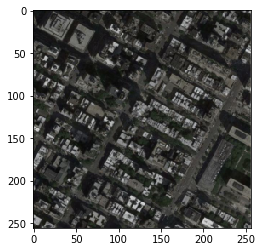

b


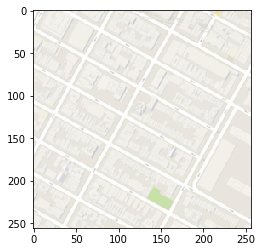

a->b


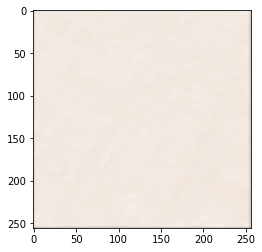

tensor(0.5232, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2919, device='cuda:0', grad_fn=<AddBackward0>)
a


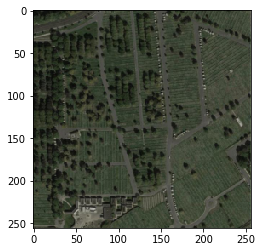

b


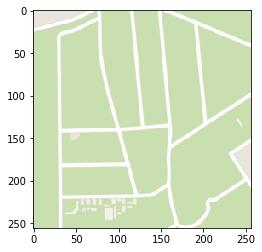

a->b


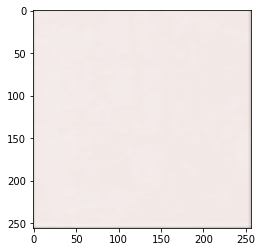

tensor(0.3973, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2323, device='cuda:0', grad_fn=<AddBackward0>)
a


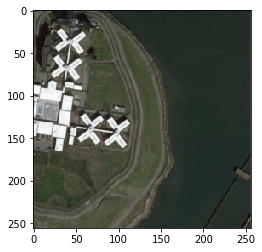

b


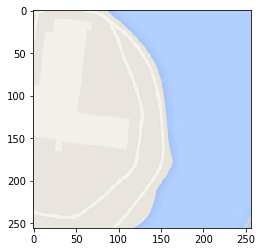

a->b


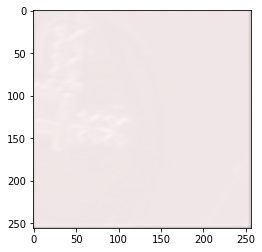

tensor(0.5102, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2481, device='cuda:0', grad_fn=<AddBackward0>)
a


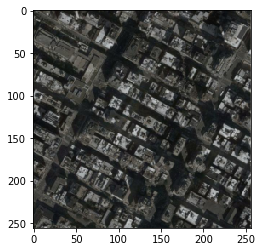

b


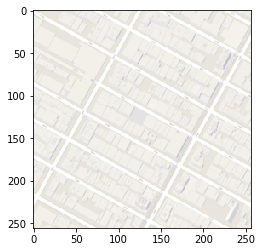

a->b


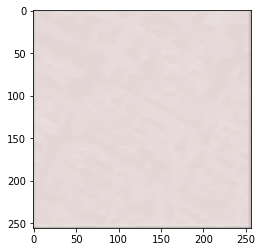

tensor(0.5048, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2877, device='cuda:0', grad_fn=<AddBackward0>)
a


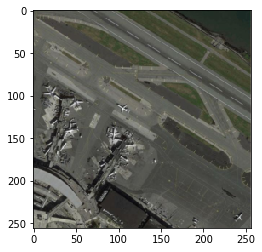

b


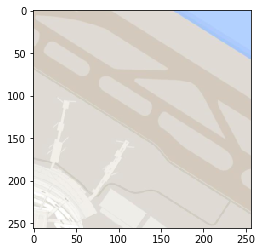

a->b


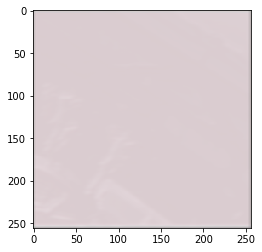

tensor(0.5003, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2392, device='cuda:0', grad_fn=<AddBackward0>)
a


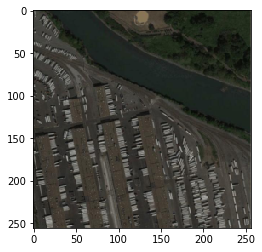

b


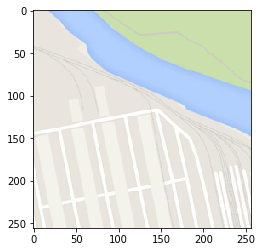

a->b


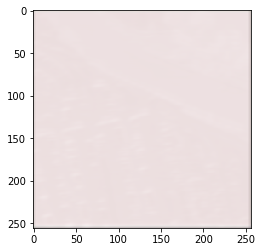

tensor(0.4939, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2434, device='cuda:0', grad_fn=<AddBackward0>)
a


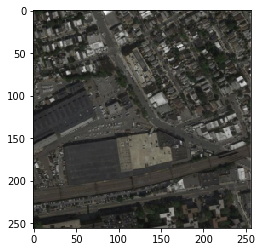

b


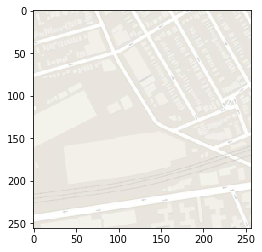

a->b


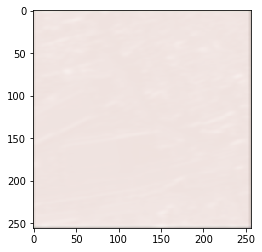

tensor(0.4408, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2929, device='cuda:0', grad_fn=<AddBackward0>)
a


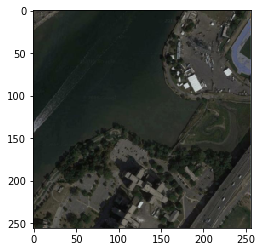

b


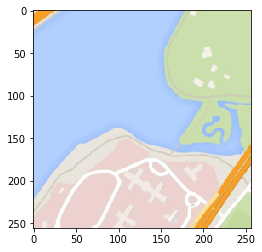

a->b


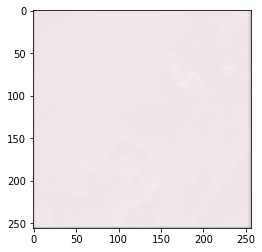

tensor(0.5000, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3161, device='cuda:0', grad_fn=<AddBackward0>)
a


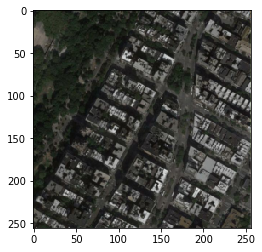

b


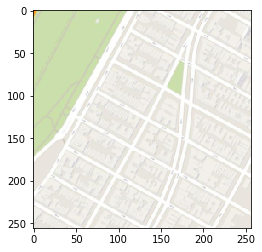

a->b


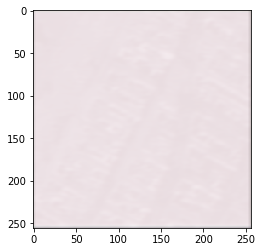

tensor(0.3462, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2840, device='cuda:0', grad_fn=<AddBackward0>)
a


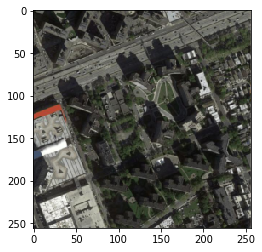

b


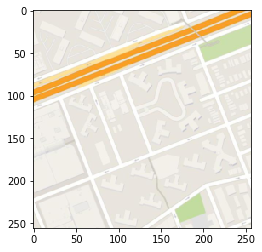

a->b


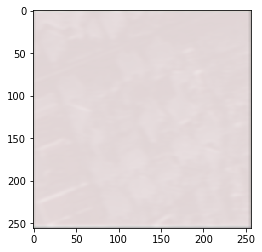

tensor(0.5006, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3119, device='cuda:0', grad_fn=<AddBackward0>)
a


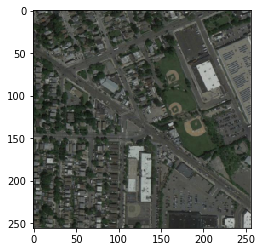

b


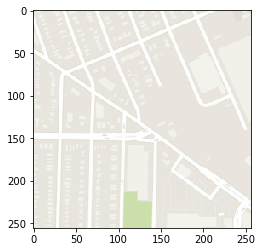

a->b


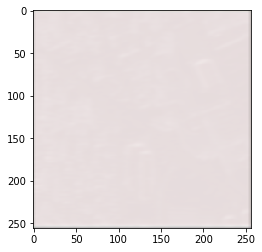

tensor(0.4005, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2770, device='cuda:0', grad_fn=<AddBackward0>)
a


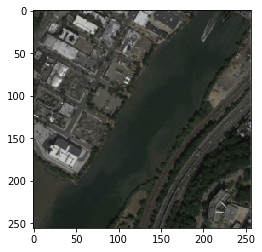

b


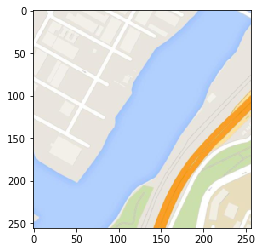

a->b


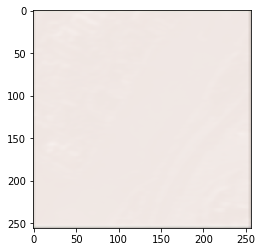

tensor(0.1771, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3463, device='cuda:0', grad_fn=<AddBackward0>)
a


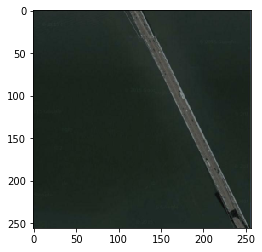

b


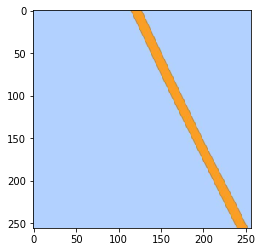

a->b


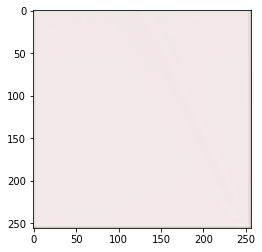

tensor(0.4039, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3835, device='cuda:0', grad_fn=<AddBackward0>)
a


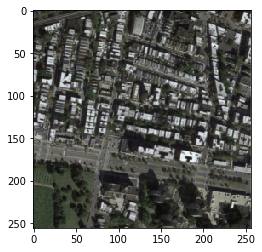

b


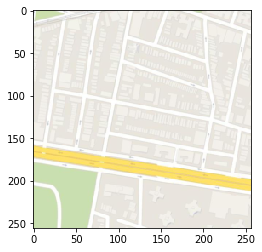

a->b


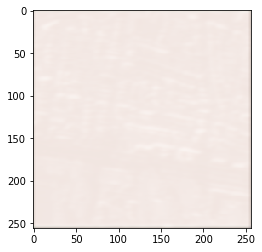

tensor(0.2591, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2563, device='cuda:0', grad_fn=<AddBackward0>)
a


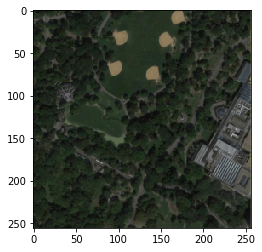

b


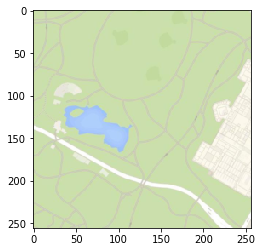

a->b


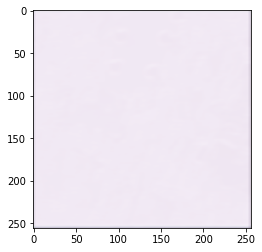

tensor(0.0261, device='cuda:0', grad_fn=<AddBackward0>) tensor(1.0137, device='cuda:0', grad_fn=<AddBackward0>)
a


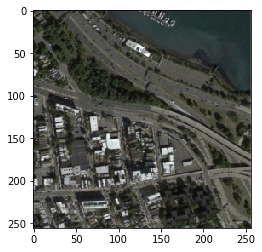

b


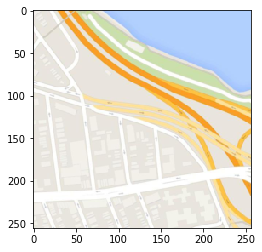

a->b


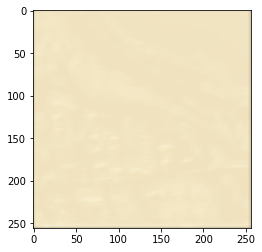

tensor(0.4100, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3451, device='cuda:0', grad_fn=<AddBackward0>)
a


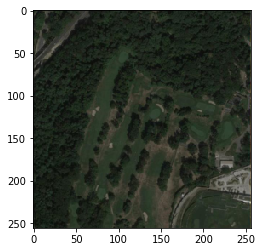

b


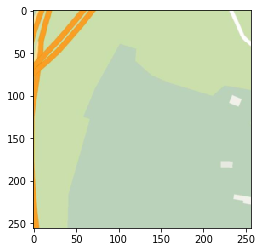

a->b


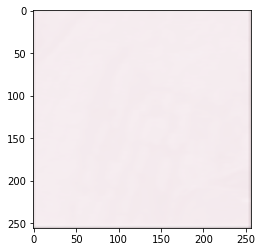

tensor(0.4618, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2766, device='cuda:0', grad_fn=<AddBackward0>)
a


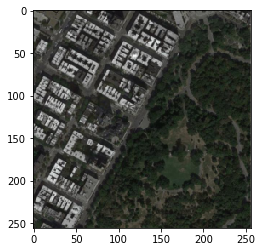

b


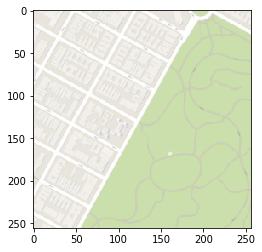

a->b


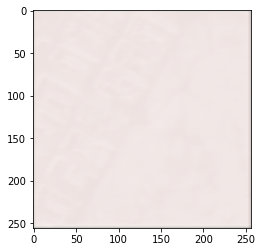

tensor(0.3736, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3632, device='cuda:0', grad_fn=<AddBackward0>)
a


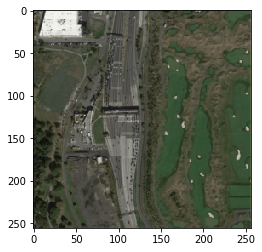

b


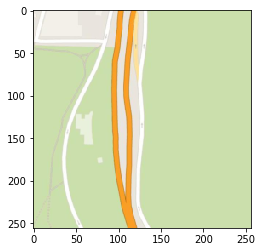

a->b


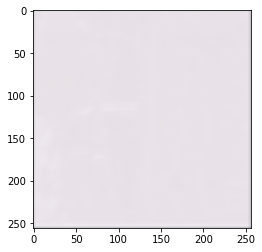

tensor(0.1871, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.4382, device='cuda:0', grad_fn=<AddBackward0>)
a


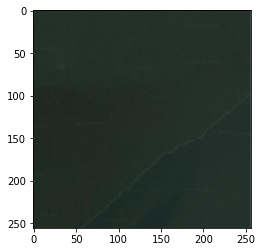

b


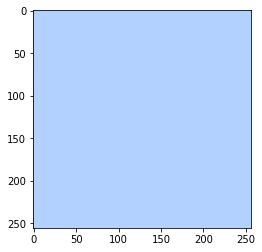

a->b


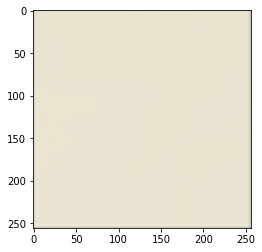

tensor(0.2553, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.4042, device='cuda:0', grad_fn=<AddBackward0>)
a


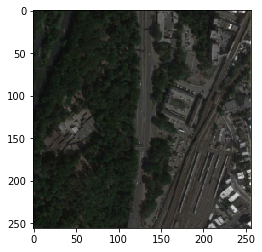

b


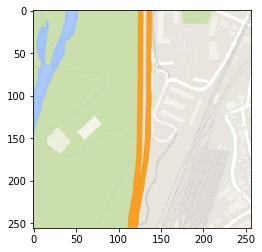

a->b


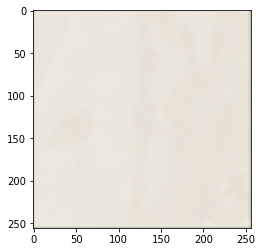

tensor(0.2681, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2430, device='cuda:0', grad_fn=<AddBackward0>)
a


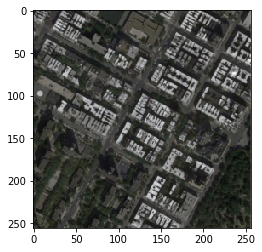

b


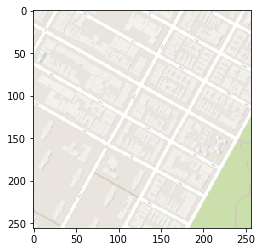

a->b


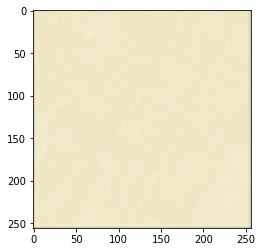

tensor(0.4276, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2863, device='cuda:0', grad_fn=<AddBackward0>)
a


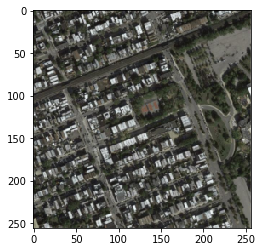

b


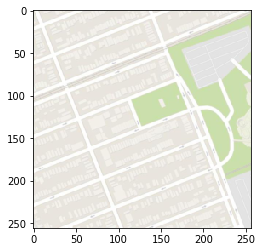

a->b


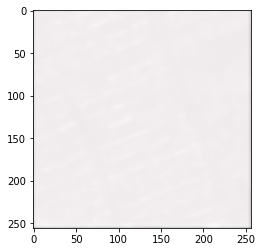

tensor(0.5005, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3421, device='cuda:0', grad_fn=<AddBackward0>)
a


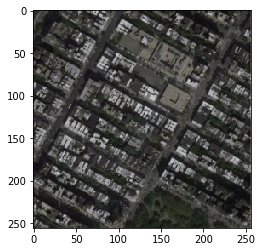

b


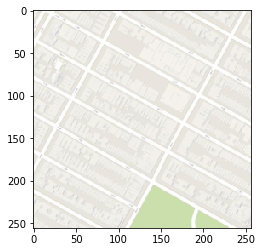

a->b


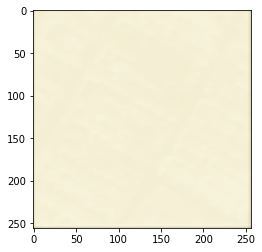

tensor(0.5858, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.4908, device='cuda:0', grad_fn=<AddBackward0>)
a


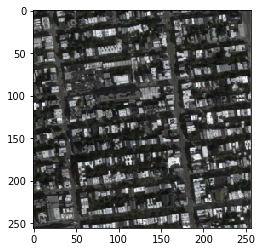

b


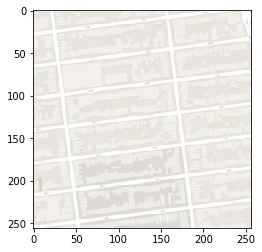

a->b


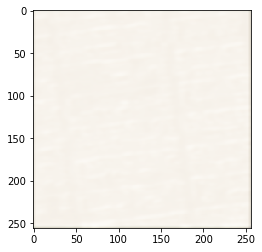

tensor(0.4369, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2398, device='cuda:0', grad_fn=<AddBackward0>)
a


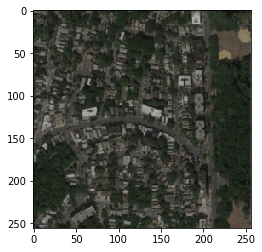

b


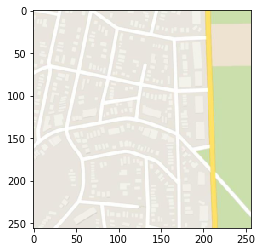

a->b


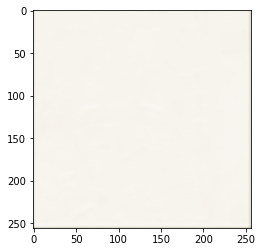

tensor(0.3926, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.5461, device='cuda:0', grad_fn=<AddBackward0>)
a


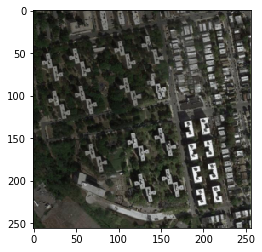

b


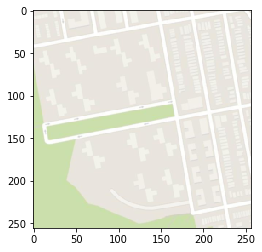

a->b


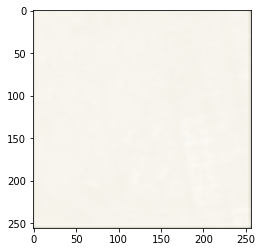

tensor(0.4227, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2909, device='cuda:0', grad_fn=<AddBackward0>)
a


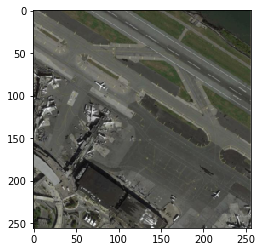

b


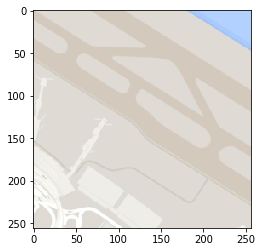

a->b


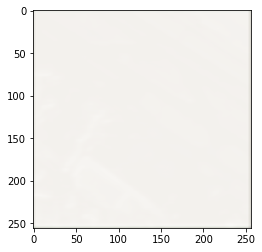

tensor(0.5207, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.4249, device='cuda:0', grad_fn=<AddBackward0>)
a


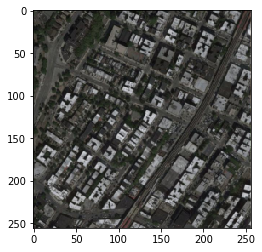

b


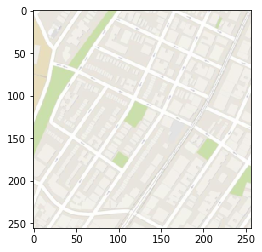

a->b


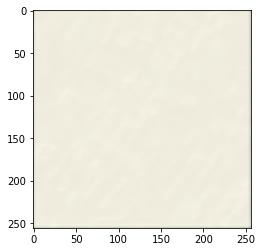

tensor(0.4675, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2243, device='cuda:0', grad_fn=<AddBackward0>)
a


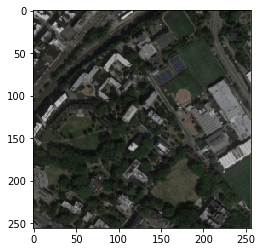

b


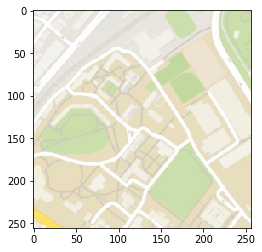

a->b


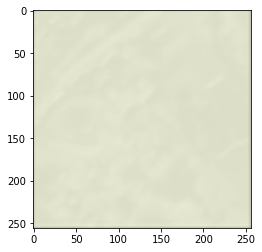

tensor(0.3832, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3429, device='cuda:0', grad_fn=<AddBackward0>)
a


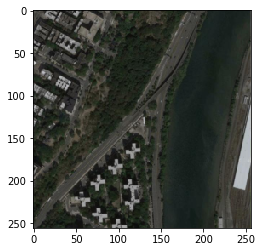

b


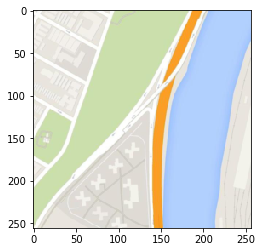

a->b


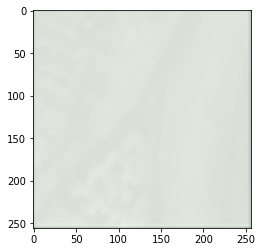

tensor(0.2930, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3604, device='cuda:0', grad_fn=<AddBackward0>)
a


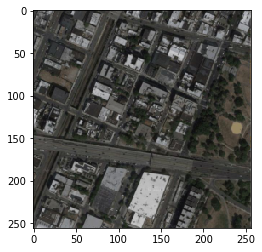

b


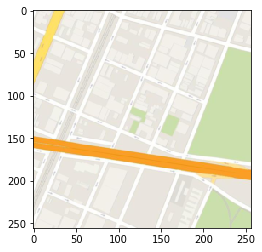

a->b


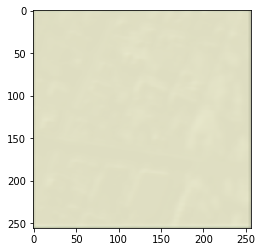

tensor(0.5336, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.4009, device='cuda:0', grad_fn=<AddBackward0>)
a


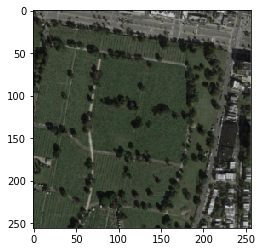

b


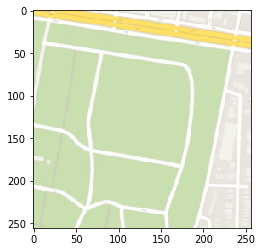

a->b


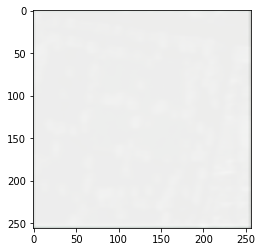

tensor(0.5990, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.4612, device='cuda:0', grad_fn=<AddBackward0>)
a


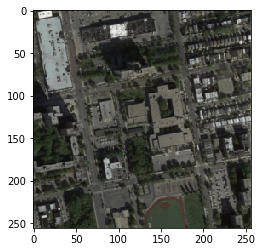

b


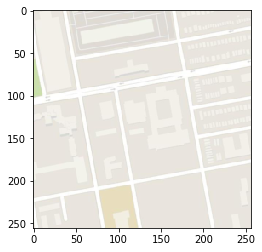

a->b


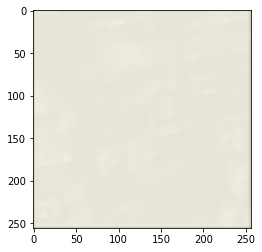

tensor(0.3617, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3747, device='cuda:0', grad_fn=<AddBackward0>)
a


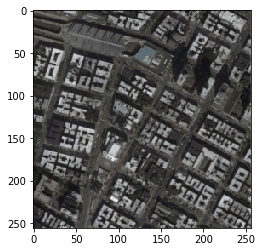

b


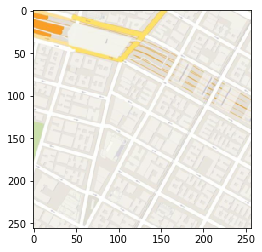

a->b


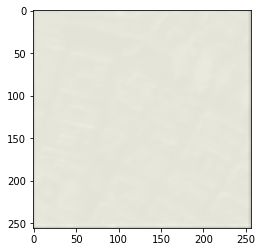

tensor(0.5173, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3199, device='cuda:0', grad_fn=<AddBackward0>)
a


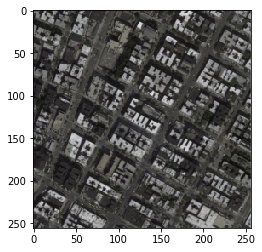

b


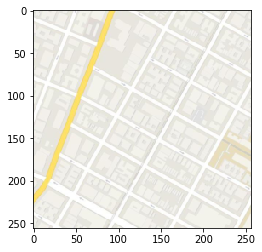

a->b


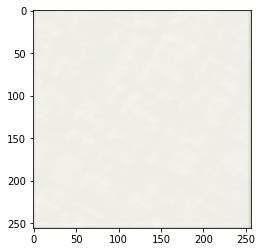

tensor(0.3847, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2987, device='cuda:0', grad_fn=<AddBackward0>)
a


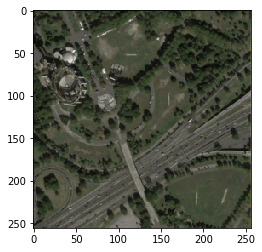

b


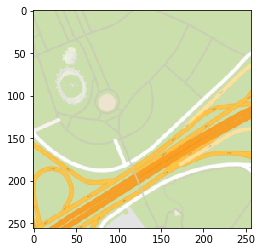

a->b


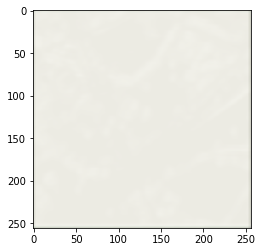

tensor(0.5075, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.4113, device='cuda:0', grad_fn=<AddBackward0>)
a


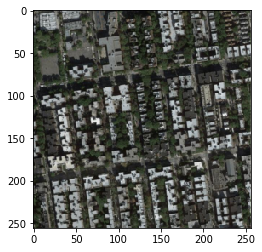

b


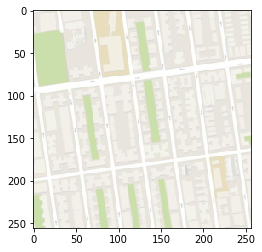

a->b


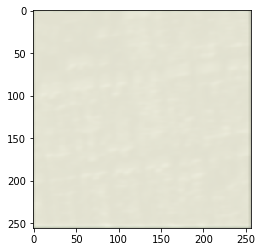

tensor(0.3568, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3494, device='cuda:0', grad_fn=<AddBackward0>)
a


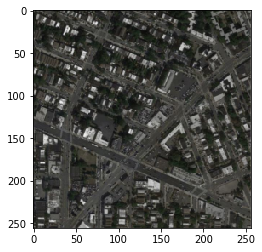

b


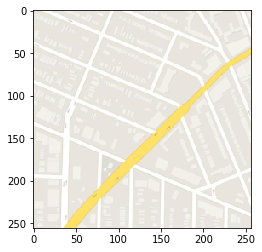

a->b


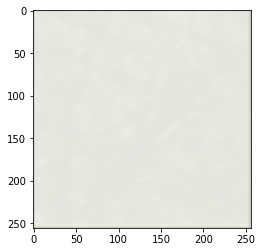

tensor(0.5013, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2914, device='cuda:0', grad_fn=<AddBackward0>)
a


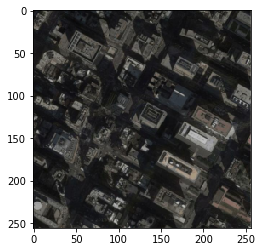

b


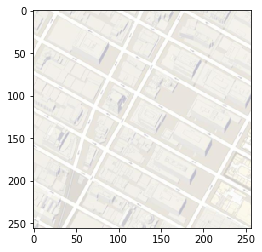

a->b


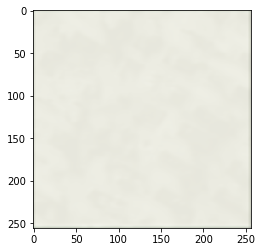

tensor(0.4907, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3094, device='cuda:0', grad_fn=<AddBackward0>)
a


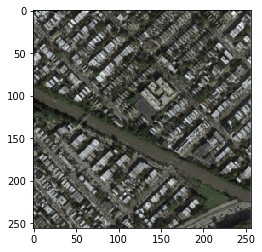

b


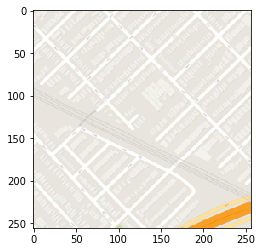

a->b


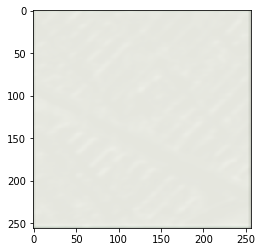

tensor(0.5225, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3779, device='cuda:0', grad_fn=<AddBackward0>)
a


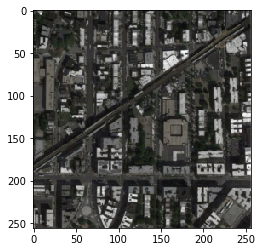

b


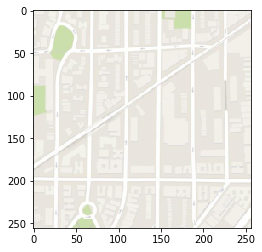

a->b


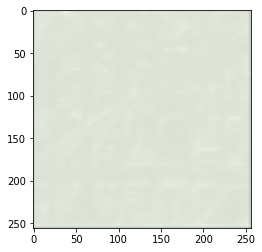

tensor(0.3622, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.6335, device='cuda:0', grad_fn=<AddBackward0>)
a


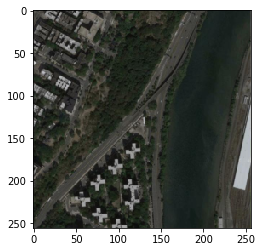

b


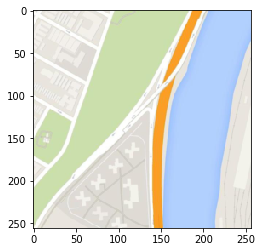

a->b


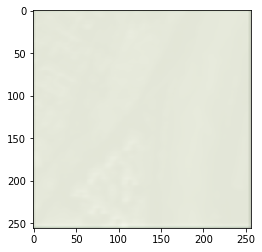

tensor(0.1342, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.4136, device='cuda:0', grad_fn=<AddBackward0>)
a


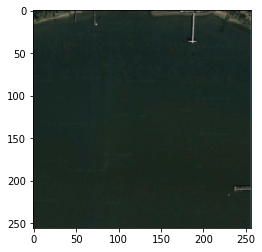

b


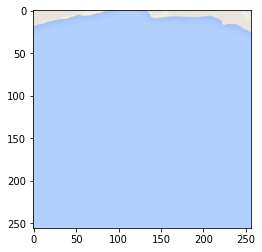

a->b


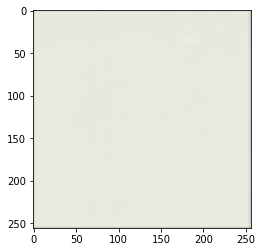

tensor(0.2683, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.4039, device='cuda:0', grad_fn=<AddBackward0>)
a


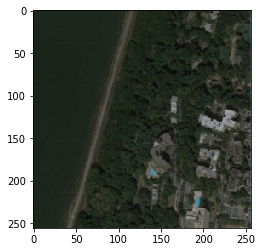

b


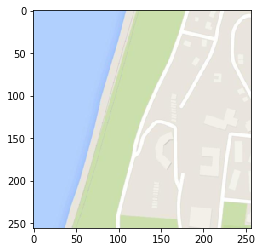

a->b


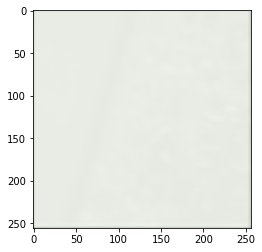

tensor(0.5246, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.4031, device='cuda:0', grad_fn=<AddBackward0>)
a


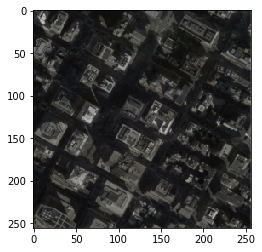

b


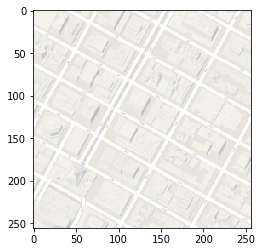

a->b


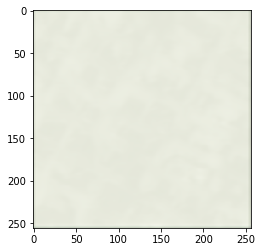

tensor(0.2774, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3802, device='cuda:0', grad_fn=<AddBackward0>)
a


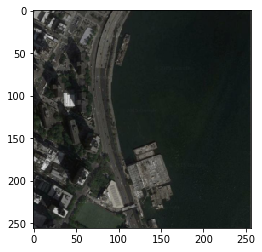

b


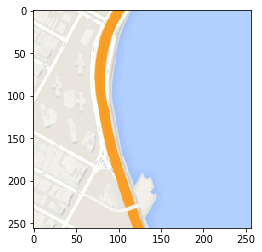

a->b


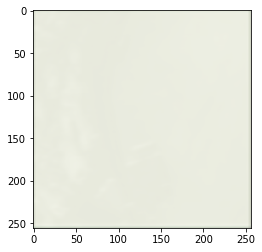

tensor(0.3280, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2533, device='cuda:0', grad_fn=<AddBackward0>)
a


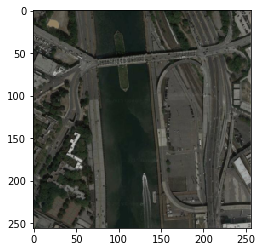

b


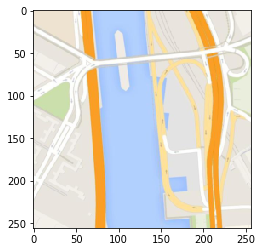

a->b


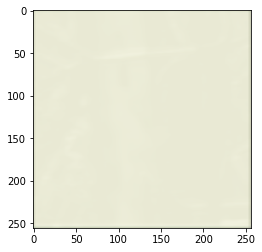

tensor(0.1757, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.3564, device='cuda:0', grad_fn=<AddBackward0>)
a


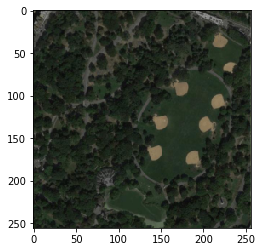

b


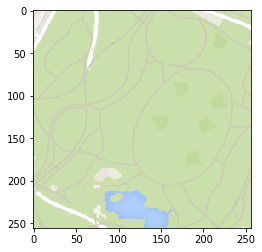

a->b


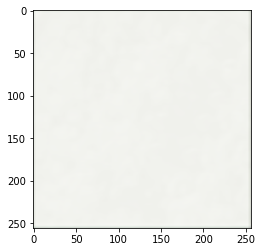

tensor(0.3796, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.4822, device='cuda:0', grad_fn=<AddBackward0>)
a


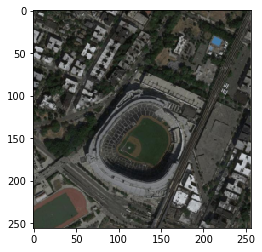

b


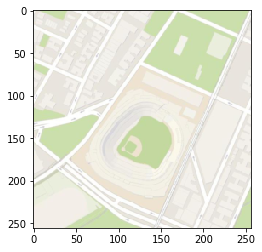

a->b


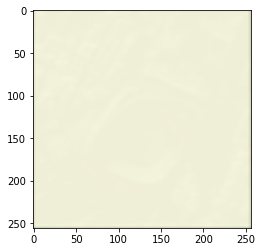

tensor(0.8302, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.8238, device='cuda:0', grad_fn=<AddBackward0>)
a


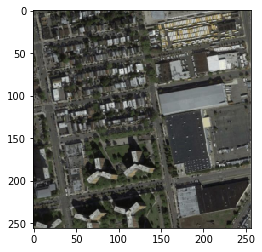

b


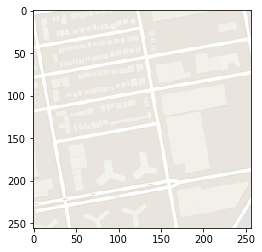

a->b


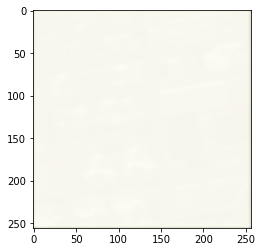

tensor(0.3759, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.4075, device='cuda:0', grad_fn=<AddBackward0>)
a


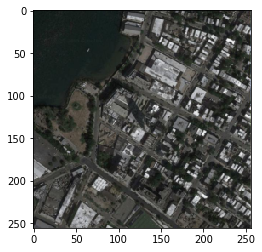

b


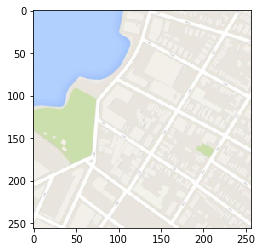

a->b


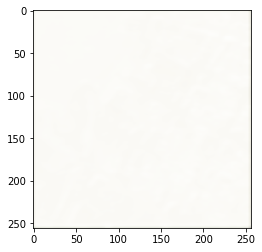

tensor(0.4502, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.2962, device='cuda:0', grad_fn=<AddBackward0>)
a


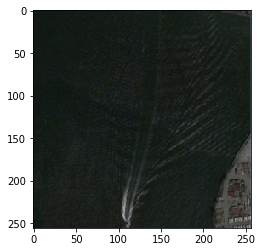

b


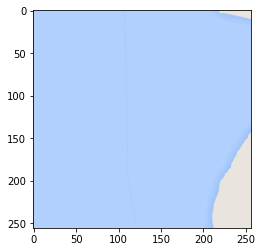

a->b


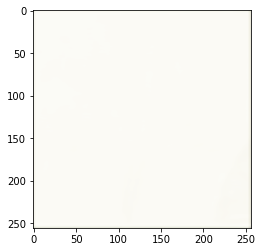

tensor(0.6065, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.5586, device='cuda:0', grad_fn=<AddBackward0>)
a


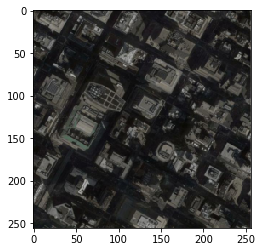

b


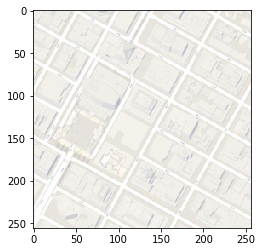

a->b


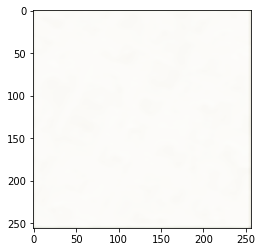

tensor(0.0742, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.7021, device='cuda:0', grad_fn=<AddBackward0>)
a


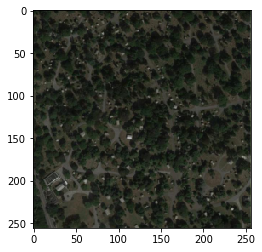

b


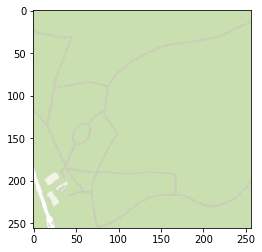

a->b


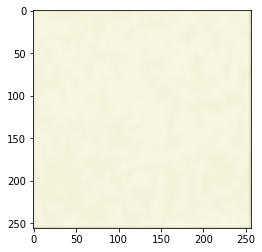

tensor(0.2226, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.4084, device='cuda:0', grad_fn=<AddBackward0>)
a


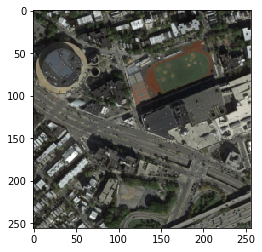

b


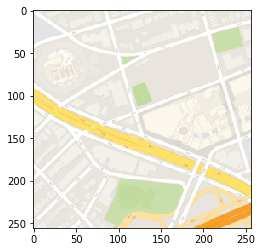

a->b


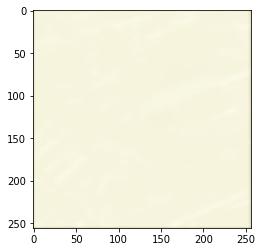

tensor(0.0028, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.9594, device='cuda:0', grad_fn=<AddBackward0>)
a


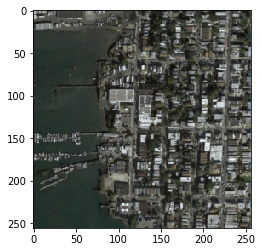

b


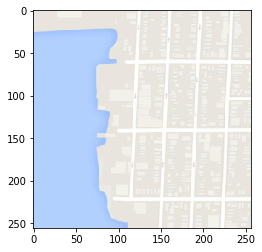

a->b


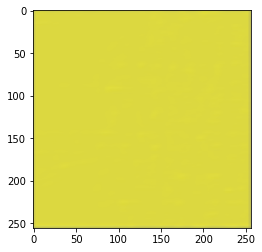

tensor(0.0004, device='cuda:0', grad_fn=<AddBackward0>) tensor(0.9872, device='cuda:0', grad_fn=<AddBackward0>)
a


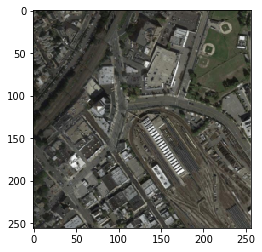

b


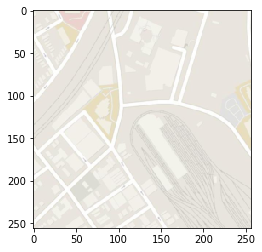

a->b


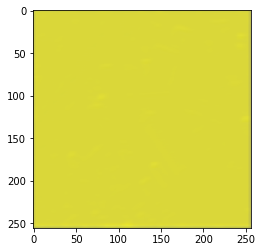

tensor(0.0004, device='cuda:0', grad_fn=<AddBackward0>) tensor(1.0143, device='cuda:0', grad_fn=<AddBackward0>)
a


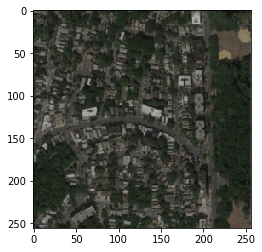

b


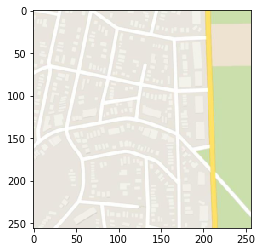

a->b


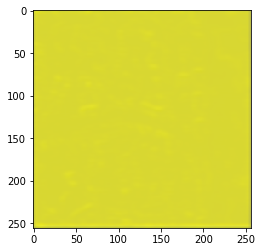

KeyboardInterrupt: 

In [110]:
batch_size=1
epoch = 100
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,shuffle=True)
g = UNet().to(device)
d = Discriminator().to(device)
#zero_ = torch.zeros((batch_size,64)).to(device)
#one_ = torch.ones((batch_size,64)).to(device)
lossfunc = nn.MSELoss()
g_opt = opt.SGD(params=g.parameters(),lr=1e-3, momentum=0.8)
d_opt = opt.SGD(params=d.parameters(),lr=1e-2, momentum=0.8)
#g_opt = opt.Adam(params=g.parameters())
#d_opt = opt.Adam(params=d.parameters())
itr = 0
for ep in range(epoch):
    for (img_a, img_b) in dataloader:
        itr+=1
        img_a = img_a.to(device)
        img_b = img_b.to(device)
        fake = g(img_a)
        real = img_b
        
        g_loss = 1e-2*torch.mean(torch.abs(fake-real))
        fake = torch.cat((img_a,fake),axis=1)
        real = torch.cat((img_a,real),axis=1)
        zero_ = torch.zeros((img_a.shape[0],16)).to(device)
        one_ = torch.ones((img_a.shape[0],16)).to(device)
        
        g_loss += lossfunc(d(fake),one_)
        #g_loss += -torch.mean(d(fake))
        g.zero_grad()
        g_loss.backward()
        g_opt.step()
                


        d_loss = lossfunc(d(real),one_) + lossfunc(d(fake.detach()),zero_)
        #d_loss = -(torch.mean(torch.min(zero_,-one_+d(real)))+torch.mean(torch.min(zero_,-one_-d(fake.detach()))))
        d.zero_grad()
        d_loss.backward()
        d_opt.step()
        if itr % 100 == 1:
            print(d_loss,g_loss)
            print("a")
            plt.imshow(img_a.detach()[0].cpu().numpy().transpose(1,2,0))
            plt.show()
            print("b")
            plt.imshow(img_b.detach()[0].cpu().numpy().transpose(1,2,0))
            plt.show()
            print("a->b")
            plt.imshow(fake.detach()[0].squeeze()[3:].cpu().numpy().transpose(1,2,0))
            plt.show()